In [1]:
import scanpy as sc
import pandas as pd 
import numpy as np
import matplotlib.pyplot as plt
from tqdm.notebook import tqdm
import warnings
import itertools as it
import json
import requests
import seaborn as sns
import pickle as pkl
from functools import reduce

/home/ssm-user/anaconda3/envs/codec/lib/python3.6/site-packages/anndata/_core/anndata.py:21: FutureWarning: pandas.core.index is deprecated and will be removed in a future version.  The public classes are available in the top-level namespace.
  from pandas.core.index import RangeIndex
/home/ssm-user/anaconda3/envs/codec/lib/python3.6/site-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


In [2]:
sc.settings.verbosity = 4
sc.settings.set_figure_params(dpi=80)
print(sc.__version__)
sc.settings.n_jobs=12

1.4.5.post1


In [3]:
prefix = '/data/codec/production.run/mrna/'

In [4]:
path = prefix + 'obs/cts/acg.t.txt'
        
with open(path,'r') as file:
    acg_t_cells = [i.strip() for i in file.readlines()]

In [5]:
path = prefix + '../cond.colors.pkl'

with open(path,'rb') as file:
    cond_colors = pkl.load(file)

In [6]:
path = prefix + 'pkls/aggr/wells.sng.w_covars.pkl'

# with open(path,'wb') as file:
#     pkl.dump(wells, file)
    
with open(path,'rb') as file:
    wells = pkl.load(file)

In [7]:
len(acg_t_cells)

46753

# RUN 1

In [9]:
acg_t_cells = np.random.choice(acg_t_cells, size=10000, replace=False)

In [10]:
for well in wells:
    wells[well]['adata'].obs_names = [i[:16] + '-%s' % well for i in wells[well]['adata'].obs_names]

In [27]:
acg_t = wells[0]['adata'].concatenate(*[wells[i]['adata'] for  i in range(1, 12)])[acg_t_cells].copy()

In [28]:
acg_t.var['n_counts'] = acg_t.X.toarray().sum(axis=0)

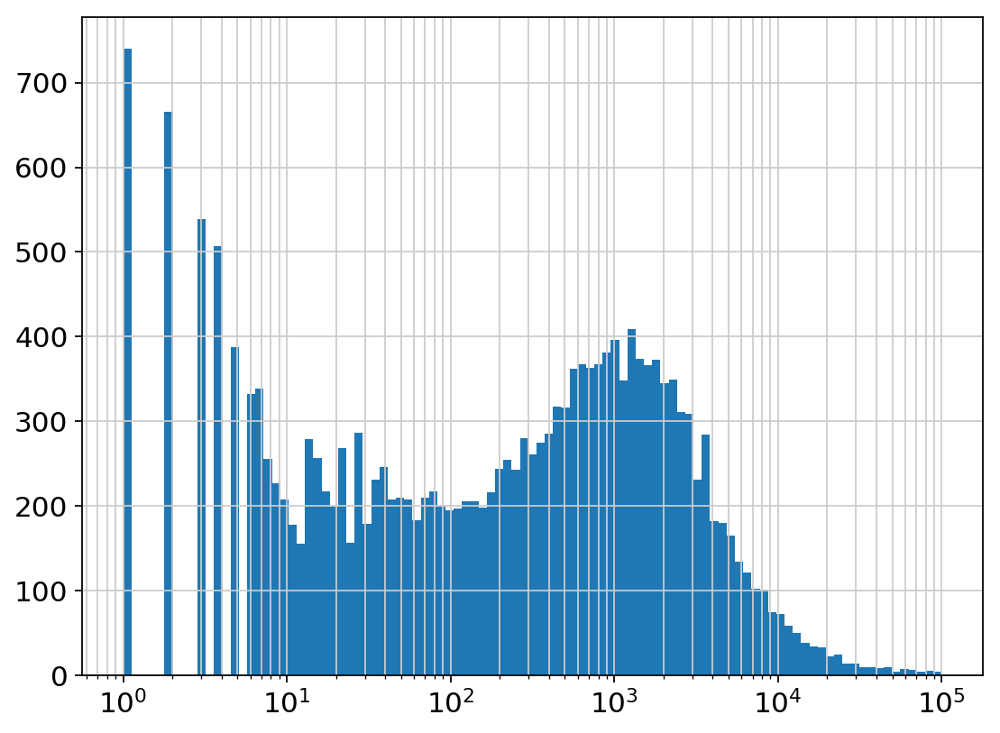

In [29]:
plt.figure(figsize=(8,6))
plt.hist(acg_t.var['n_counts'].values, bins=np.logspace(np.log10(1),np.log10(1e5), 100))
plt.grid(False)
plt.grid(True, 'both', 'both')
plt.xscale('log')
# plt.yscale('log')

In [30]:
# remove any genes that are now empty
sc.pp.filter_genes(acg_t, min_counts=20, inplace=True)
sc.pp.normalize_per_cell(acg_t, counts_per_cell_after=1e6)
sc.pp.log1p(acg_t)

filtered out 6194 genes that are detected in less than 20 counts
normalizing by total count per cell
    finished (0:00:00): normalized adata.X and added    'n_counts', counts per cell before normalization (adata.obs)


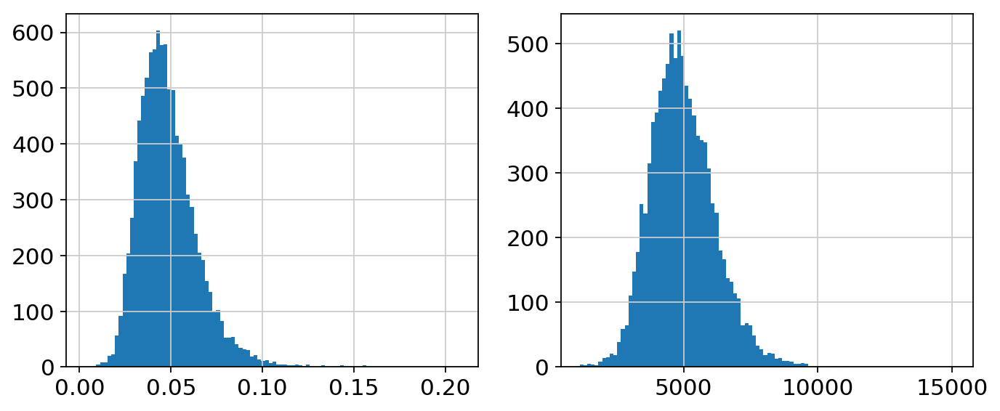

In [31]:
fig, ax = plt.subplots(1,2,figsize=(10,4))
for vals, ax in zip(['percent_mito','n_counts'], np.ravel(ax)):
    ax.hist(acg_t.obs[vals].values,bins=100)

In [32]:
sc.pp.scale(acg_t)
sc.pp.regress_out(acg_t, ['percent_mito','n_counts'],n_jobs=1)
sc.pp.scale(acg_t)
sc.pp.combat(acg_t, key='batch',covariates=['cond','free_id'])
sc.pp.scale(acg_t)
sc.pp.pca(acg_t, n_comps=200)

    ... scale_data: as `zero_center=True`, sparse input is densified and may lead to large memory consumption.
regressing out ['percent_mito', 'n_counts']


... storing 'DROPLET.TYPE' as categorical
... storing 'cond' as categorical
... storing 'exp_id' as categorical
... storing 'free_id' as categorical
... storing 'pool_code' as categorical
... storing 'feature_types' as categorical
... storing 'genome' as categorical


    finished (0:02:38)
Standardizing Data across genes.

Found 12 batches

Found 2 categorical variables:
	cond, free_id

Found 0 numerical variables:
	

Fitting L/S model and finding priors

Finding parametric adjustments

Adjusting data

computing PCA with n_comps = 200
    finished (0:02:10)
    and added
    'X_pca', the PCA coordinates (adata.obs)
    'PC1', 'PC2', ..., the loadings (adata.var)
    'pca_variance', the variance / eigenvalues (adata.uns)
    'pca_variance_ratio', the variance ratio (adata.uns)


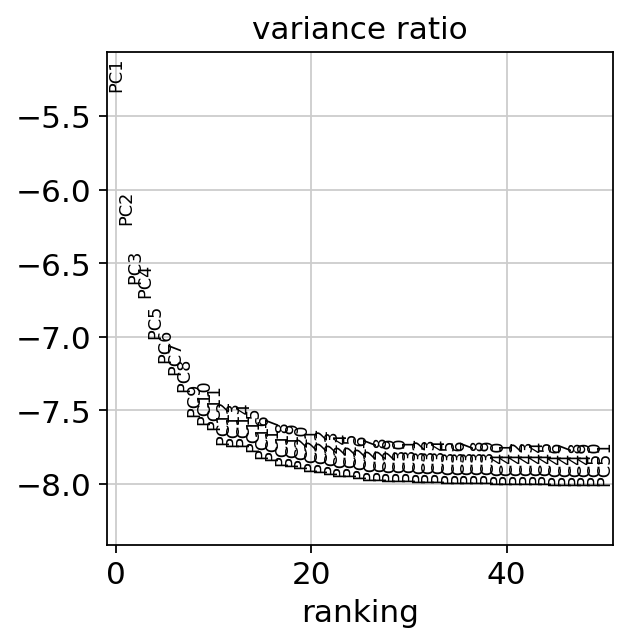

In [34]:
sc.pl.pca_variance_ratio(acg_t,log=True, n_pcs=50)

In [38]:
df_loadings = pd.DataFrame(acg_t.varm['PCs'], index=acg_t.var_names)
df_rankings = pd.DataFrame((-1 * df_loadings.values).argsort(0).argsort(0), index=df_loadings.index, columns=df_loadings.columns)

In [39]:
num = 50
percent_ribos = dict()
percent_mitos = dict()
for direction, boolean in zip(['corr', 'anti-corr'], [False, True]):
    percent_ribos[direction] = list()
    percent_mitos[direction] = list()
    for pc in range(200):
        top_genes = df_loadings[pc].sort_values(ascending=boolean)[:num].index
        percent_ribos[direction].append(len([i for i in top_genes if i.startswith('RP')])/num)
        percent_mitos[direction].append(len([i for i in top_genes if i.startswith('MT')])/num)

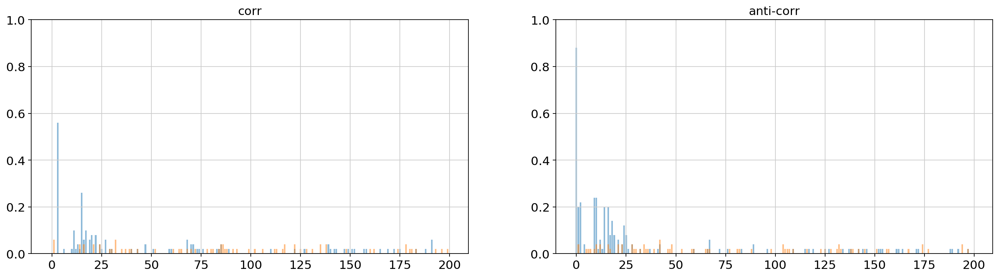

In [40]:
fig, ax = plt.subplots(1, 2, figsize=(20, 5))
for direction, ax in zip(['corr', 'anti-corr'], ax):
    ax.bar(range(len(percent_ribos[direction])), percent_ribos[direction], alpha=0.5)
    ax.bar(range(len(percent_mitos[direction])), percent_mitos[direction], alpha=0.5)
    ax.set_title(direction)
    ax.set_ylim((0, 1))

In [42]:
warnings.filterwarnings('ignore')
sc.pp.neighbors(acg_t,n_neighbors=15,n_pcs=40)
warnings.filterwarnings('default')

computing neighbors
    computing neighbors
    using 'X_pca' with n_pcs = 40
    computed neighbors (0:00:06)
    computed connectivities (0:00:02)
    finished: added to `.uns['neighbors']`
    'distances', distances for each pair of neighbors
    'connectivities', weighted adjacency matrix (0:00:09)


In [43]:
sc.tl.umap(acg_t)

computing UMAP
	completed  0  /  500 epochs
	completed  50  /  500 epochs
	completed  100  /  500 epochs
	completed  150  /  500 epochs
	completed  200  /  500 epochs
	completed  250  /  500 epochs
	completed  300  /  500 epochs
	completed  350  /  500 epochs
	completed  400  /  500 epochs
	completed  450  /  500 epochs
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:27)


In [44]:
sc.tl.leiden(acg_t, resolution=1)

running Leiden clustering
    finished: found 9 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:02)


# Visualization

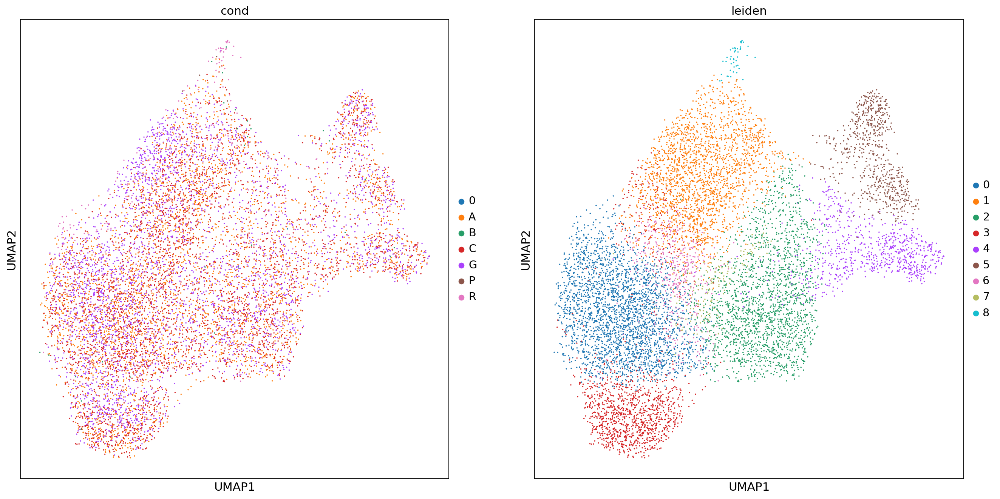

In [45]:
fig, ax = plt.subplots(1, 2, figsize=(20,10))
for color, ax, palette in zip(['cond', 'leiden'], ax, [None, sc.pl.palettes.default_20]):
    sc.pl.umap(acg_t,color=color, ax=ax, show=False, return_fig=False, size=10, palette=palette)

In [46]:
def add_raw(adata, transformed=True):
    path = prefix + 'pkls/aggr/wells.sng.w_covars.pkl'
    
    with open(path,'rb') as file:
        wells = pkl.load(file)
    
    for well in wells:
        wells[well]['adata'].obs_names = [i[:16] + '-%s' % well for i in wells[well]['adata'].obs_names]
    
    raw = wells[0]['adata'].concatenate(*[wells[i]['adata'] for  i in range(1, 12)])[adata.obs_names,:]
    
    if transformed == True:
        sc.pp.normalize_per_cell(raw,counts_per_cell_after=1e6)
        sc.pp.log1p(raw)
    
    adata.raw = raw
    return

In [48]:
add_raw(acg_t)

normalizing by total count per cell


Trying to set attribute `.obs` of view, copying.


    finished (0:00:00): normalized adata.X and added    'n_counts', counts per cell before normalization (adata.obs)


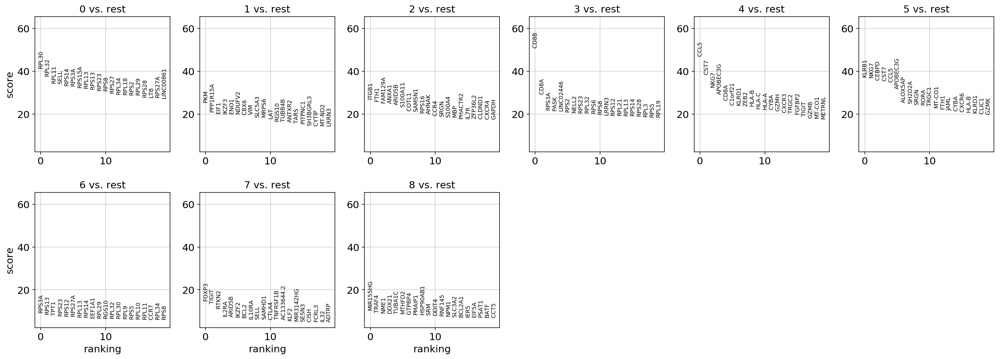

In [49]:
sc.settings.verbosity = 0
warnings.filterwarnings('ignore')
sc.tl.rank_genes_groups(acg_t, groupby='leiden', n_genes=100, use_raw=True)
warnings.filterwarnings('default')
sc.pl.rank_genes_groups(acg_t, ncols=6, n_genes=20)
sc.settings.verbosity = 4

In [52]:
path = '/data/codec/production.run/adts/pkls/combat/concat.combat.adts.norm.log.pkl'
with open(path,'rb') as file:
    concat_adts = pkl.load(file)
transcripts = acg_t.var_names
proteins = concat_adts['adata'].var_names
adts_df = pd.DataFrame(concat_adts['adata'].X, columns=proteins, index=concat_adts['adata'].obs_names)
acg_t.obs = acg_t.obs.join(adts_df)

In [50]:
features = ['CD8|CD8A','CD8A','CD4|CD4','CD4']

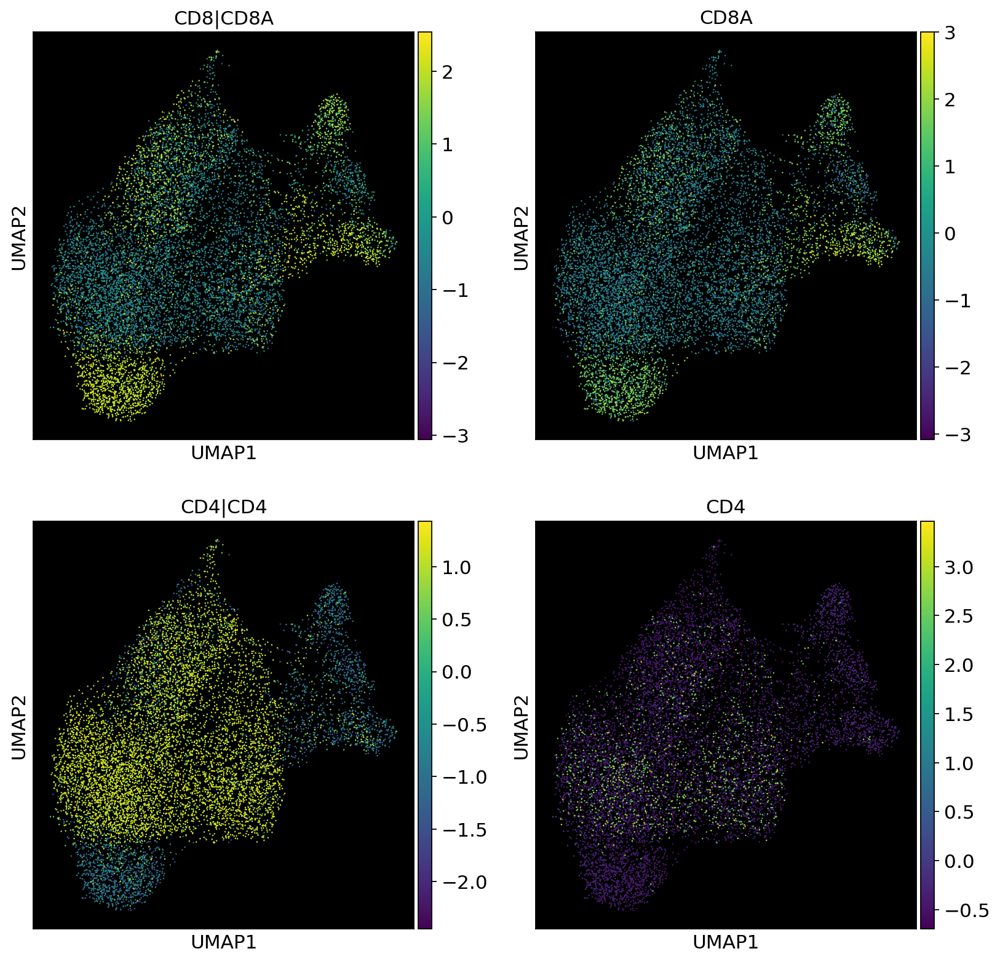

In [53]:
fig, ax = plt.subplots(2,2,figsize=(12,12))
for ax, f in zip(np.ravel(ax), features):
    ax.set_facecolor('black')
    sc.pl.umap(acg_t, color=f, ax=ax,show=False, return_fig=False, size=5, use_raw=False)

# RUN 2

In [54]:
acg_t_cells = np.random.choice(acg_t_cells, size=10000, replace=False)

In [55]:
for well in wells:
    wells[well]['adata'].obs_names = [i[:16] + '-%s' % well for i in wells[well]['adata'].obs_names]

In [56]:
acg_t = wells[0]['adata'].concatenate(*[wells[i]['adata'] for  i in range(1, 12)])[acg_t_cells].copy()

In [57]:
acg_t.var['n_counts'] = acg_t.X.toarray().sum(axis=0)

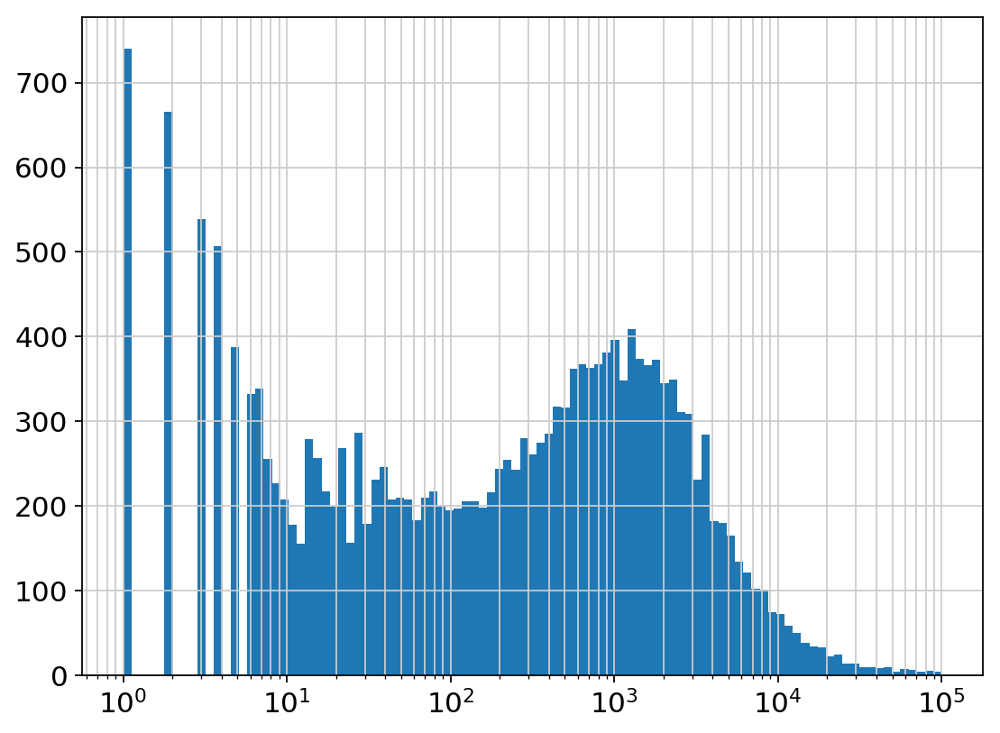

In [58]:
plt.figure(figsize=(8,6))
plt.hist(acg_t.var['n_counts'].values, bins=np.logspace(np.log10(1),np.log10(1e5), 100))
plt.grid(False)
plt.grid(True, 'both', 'both')
plt.xscale('log')
# plt.yscale('log')

In [59]:
# remove any genes that are now empty
sc.pp.filter_genes(acg_t, min_counts=20, inplace=True)
sc.pp.normalize_per_cell(acg_t, counts_per_cell_after=1e6)
sc.pp.log1p(acg_t)

filtered out 6194 genes that are detected in less than 20 counts
normalizing by total count per cell
    finished (0:00:00): normalized adata.X and added    'n_counts', counts per cell before normalization (adata.obs)


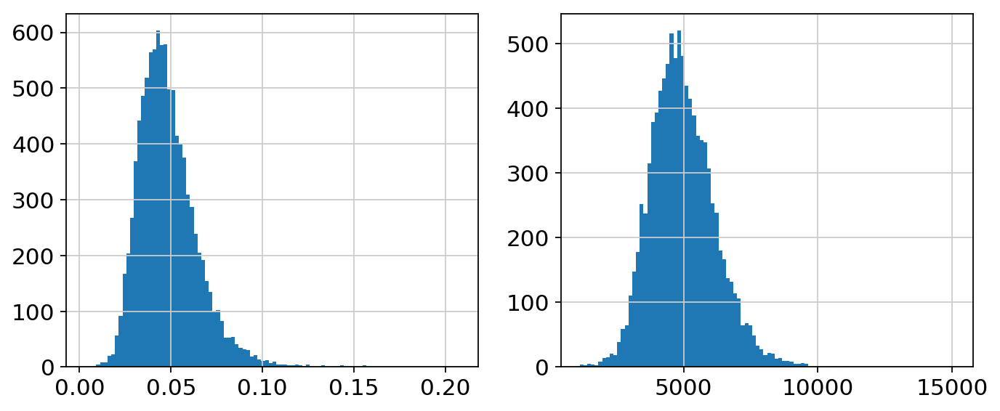

In [60]:
fig, ax = plt.subplots(1,2,figsize=(10,4))
for vals, ax in zip(['percent_mito','n_counts'], np.ravel(ax)):
    ax.hist(acg_t.obs[vals].values,bins=100)

In [61]:
sc.pp.scale(acg_t)
sc.pp.regress_out(acg_t, ['percent_mito','n_counts'],n_jobs=1)
sc.pp.scale(acg_t)
sc.pp.combat(acg_t, key='batch',covariates=['cond','free_id'])
sc.pp.scale(acg_t)
sc.pp.pca(acg_t, n_comps=200)

    ... scale_data: as `zero_center=True`, sparse input is densified and may lead to large memory consumption.
regressing out ['percent_mito', 'n_counts']


... storing 'DROPLET.TYPE' as categorical
... storing 'cond' as categorical
... storing 'exp_id' as categorical
... storing 'free_id' as categorical
... storing 'pool_code' as categorical
... storing 'feature_types' as categorical
... storing 'genome' as categorical


    finished (0:02:36)
Standardizing Data across genes.

Found 12 batches

Found 2 categorical variables:
	cond, free_id

Found 0 numerical variables:
	

Fitting L/S model and finding priors

Finding parametric adjustments

Adjusting data

computing PCA with n_comps = 200
    finished (0:02:07)
    and added
    'X_pca', the PCA coordinates (adata.obs)
    'PC1', 'PC2', ..., the loadings (adata.var)
    'pca_variance', the variance / eigenvalues (adata.uns)
    'pca_variance_ratio', the variance ratio (adata.uns)


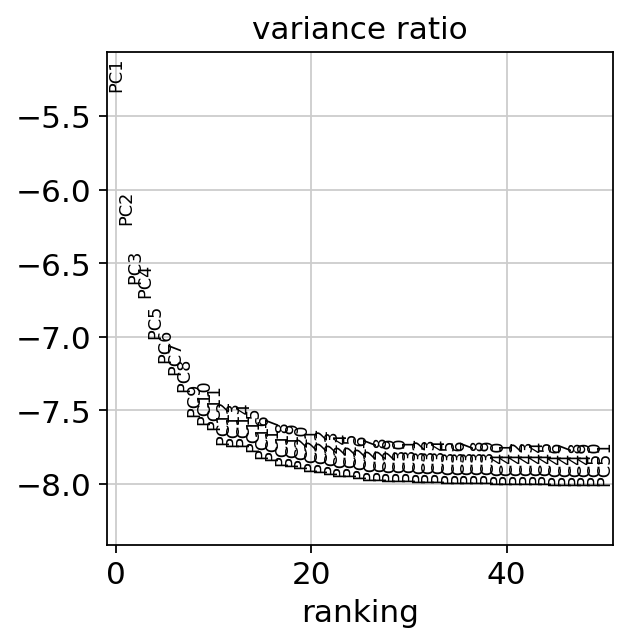

In [62]:
sc.pl.pca_variance_ratio(acg_t,log=True, n_pcs=50)

In [63]:
df_loadings = pd.DataFrame(acg_t.varm['PCs'], index=acg_t.var_names)
df_rankings = pd.DataFrame((-1 * df_loadings.values).argsort(0).argsort(0), index=df_loadings.index, columns=df_loadings.columns)

In [64]:
num = 50
percent_ribos = dict()
percent_mitos = dict()
for direction, boolean in zip(['corr', 'anti-corr'], [False, True]):
    percent_ribos[direction] = list()
    percent_mitos[direction] = list()
    for pc in range(200):
        top_genes = df_loadings[pc].sort_values(ascending=boolean)[:num].index
        percent_ribos[direction].append(len([i for i in top_genes if i.startswith('RP')])/num)
        percent_mitos[direction].append(len([i for i in top_genes if i.startswith('MT')])/num)

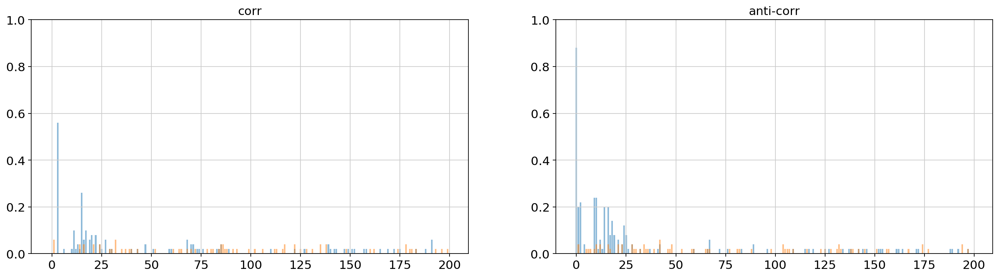

In [65]:
fig, ax = plt.subplots(1, 2, figsize=(20, 5))
for direction, ax in zip(['corr', 'anti-corr'], ax):
    ax.bar(range(len(percent_ribos[direction])), percent_ribos[direction], alpha=0.5)
    ax.bar(range(len(percent_mitos[direction])), percent_mitos[direction], alpha=0.5)
    ax.set_title(direction)
    ax.set_ylim((0, 1))

In [66]:
acg_t.obs['ribo_pc'] = acg_t.obsm['X_pca'][:,0]

In [67]:
warnings.filterwarnings('ignore')
sc.pp.regress_out(acg_t, 'ribo_pc', n_jobs=1)
warnings.filterwarnings('default')

regressing out ribo_pc
    finished (0:01:42)


In [68]:
sc.pp.scale(acg_t)
sc.pp.pca(acg_t, n_comps=200)

computing PCA with n_comps = 200
    finished (0:02:10)
    and added
    'X_pca', the PCA coordinates (adata.obs)
    'PC1', 'PC2', ..., the loadings (adata.var)
    'pca_variance', the variance / eigenvalues (adata.uns)
    'pca_variance_ratio', the variance ratio (adata.uns)


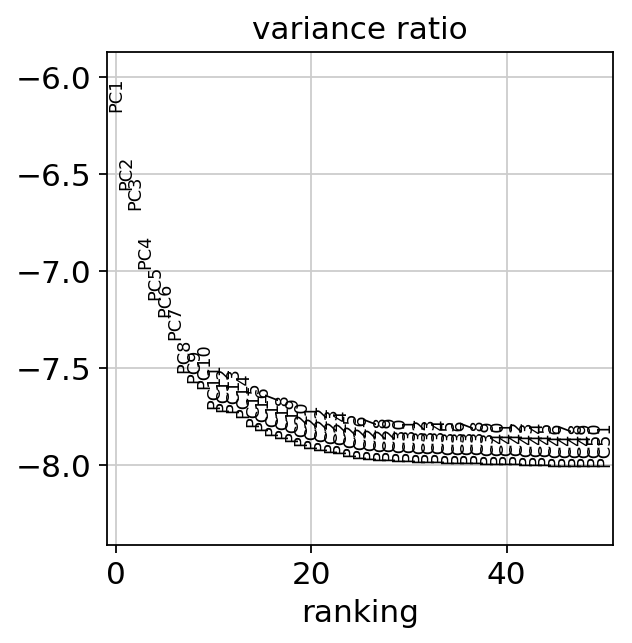

In [69]:
sc.pl.pca_variance_ratio(acg_t,log=True, n_pcs=50)

In [70]:
df_loadings = pd.DataFrame(acg_t.varm['PCs'], index=acg_t.var_names)
df_rankings = pd.DataFrame((-1 * df_loadings.values).argsort(0).argsort(0), index=df_loadings.index, columns=df_loadings.columns)

In [71]:
num = 50
percent_ribos = dict()
percent_mitos = dict()
for direction, boolean in zip(['corr', 'anti-corr'], [False, True]):
    percent_ribos[direction] = list()
    percent_mitos[direction] = list()
    for pc in range(200):
        top_genes = df_loadings[pc].sort_values(ascending=boolean)[:num].index
        percent_ribos[direction].append(len([i for i in top_genes if i.startswith('RP')])/num)
        percent_mitos[direction].append(len([i for i in top_genes if i.startswith('MT')])/num)

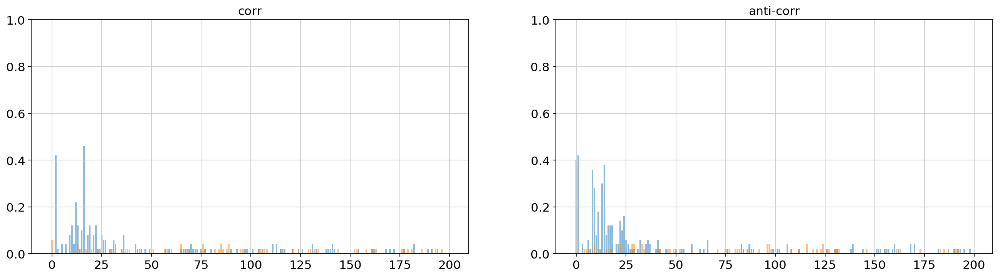

In [72]:
fig, ax = plt.subplots(1, 2, figsize=(20, 5))
for direction, ax in zip(['corr', 'anti-corr'], ax):
    ax.bar(range(len(percent_ribos[direction])), percent_ribos[direction], alpha=0.5)
    ax.bar(range(len(percent_mitos[direction])), percent_mitos[direction], alpha=0.5)
    ax.set_title(direction)
    ax.set_ylim((0, 1))

In [73]:
warnings.filterwarnings('ignore')
sc.pp.neighbors(acg_t,n_neighbors=15,n_pcs=40)
warnings.filterwarnings('default')

computing neighbors
    computing neighbors
    using 'X_pca' with n_pcs = 40
    computed neighbors (0:00:03)
    computed connectivities (0:00:00)
    finished: added to `.uns['neighbors']`
    'distances', distances for each pair of neighbors
    'connectivities', weighted adjacency matrix (0:00:04)


In [74]:
sc.tl.umap(acg_t)

computing UMAP
	completed  0  /  500 epochs
	completed  50  /  500 epochs
	completed  100  /  500 epochs
	completed  150  /  500 epochs
	completed  200  /  500 epochs
	completed  250  /  500 epochs
	completed  300  /  500 epochs
	completed  350  /  500 epochs
	completed  400  /  500 epochs
	completed  450  /  500 epochs
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:26)


In [75]:
sc.tl.leiden(acg_t, resolution=1)

running Leiden clustering
    finished: found 10 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:05)


# Visualization

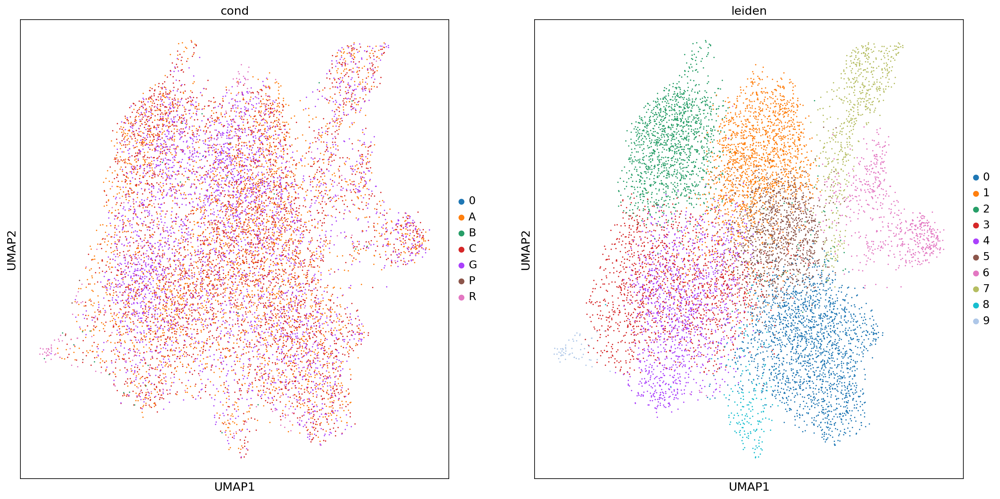

In [76]:
fig, ax = plt.subplots(1, 2, figsize=(20,10))
for color, ax, palette in zip(['cond', 'leiden'], ax, [None, sc.pl.palettes.default_20]):
    sc.pl.umap(acg_t,color=color, ax=ax, show=False, return_fig=False, size=10, palette=palette)

In [77]:
def add_raw(adata, transformed=True):
    path = prefix + 'pkls/aggr/wells.sng.w_covars.pkl'
    
    with open(path,'rb') as file:
        wells = pkl.load(file)
    
    for well in wells:
        wells[well]['adata'].obs_names = [i[:16] + '-%s' % well for i in wells[well]['adata'].obs_names]
    
    raw = wells[0]['adata'].concatenate(*[wells[i]['adata'] for  i in range(1, 12)])[adata.obs_names,:]
    
    if transformed == True:
        sc.pp.normalize_per_cell(raw,counts_per_cell_after=1e6)
        sc.pp.log1p(raw)
    
    adata.raw = raw
    return

In [78]:
add_raw(acg_t)

normalizing by total count per cell


Trying to set attribute `.obs` of view, copying.


    finished (0:00:00): normalized adata.X and added    'n_counts', counts per cell before normalization (adata.obs)


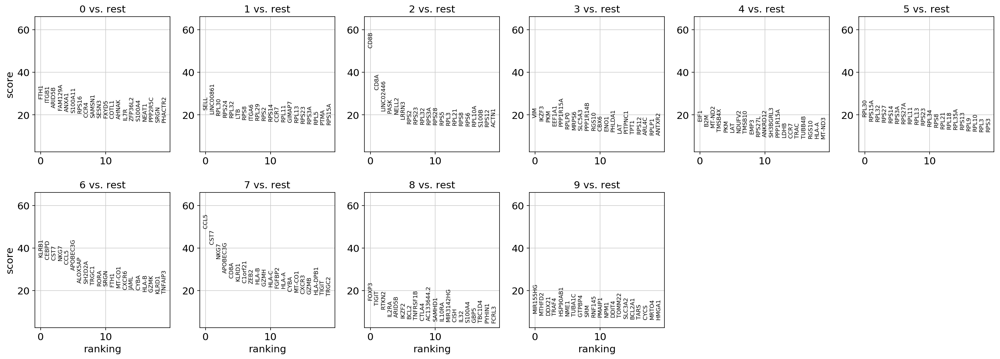

In [79]:
sc.settings.verbosity = 0
warnings.filterwarnings('ignore')
sc.tl.rank_genes_groups(acg_t, groupby='leiden', n_genes=100, use_raw=True)
warnings.filterwarnings('default')
sc.pl.rank_genes_groups(acg_t, ncols=6, n_genes=20)
sc.settings.verbosity = 4

In [80]:
path = '/data/codec/production.run/adts/pkls/combat/concat.combat.adts.norm.log.pkl'
with open(path,'rb') as file:
    concat_adts = pkl.load(file)
transcripts = acg_t.var_names
proteins = concat_adts['adata'].var_names
adts_df = pd.DataFrame(concat_adts['adata'].X, columns=proteins, index=concat_adts['adata'].obs_names)
acg_t.obs = acg_t.obs.join(adts_df)

In [94]:
features = ['CD8|CD8A','CD8A','CD4|CD4','CD4']

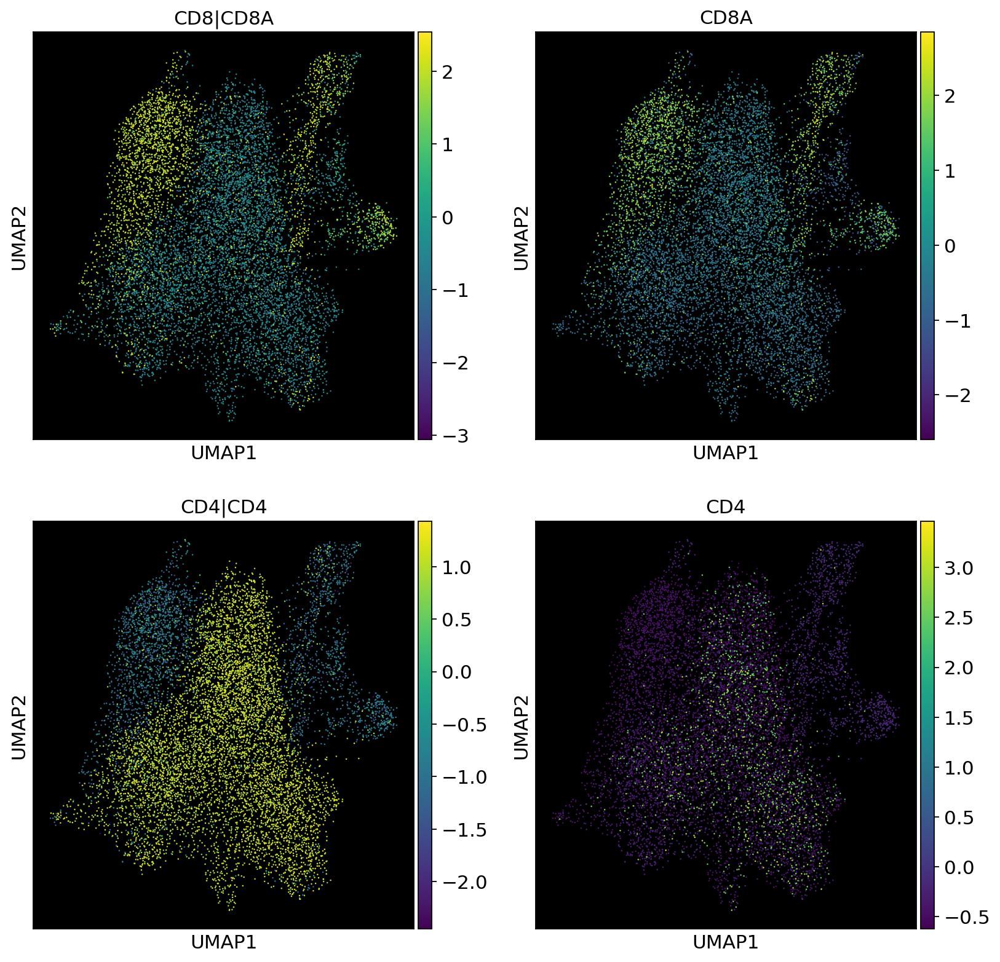

In [95]:
fig, ax = plt.subplots(2,2,figsize=(12,12))
for ax, f in zip(np.ravel(ax), features):
    ax.set_facecolor('black')
    sc.pl.umap(acg_t, color=f, ax=ax,show=False, return_fig=False, size=5, use_raw=False)

# RUN 3

In [96]:
acg_t_cells = np.random.choice(acg_t_cells, size=10000, replace=False)

In [97]:
for well in wells:
    wells[well]['adata'].obs_names = [i[:16] + '-%s' % well for i in wells[well]['adata'].obs_names]

In [98]:
acg_t = wells[0]['adata'].concatenate(*[wells[i]['adata'] for  i in range(1, 12)])[acg_t_cells].copy()

In [99]:
acg_t.var['n_counts'] = acg_t.X.toarray().sum(axis=0)

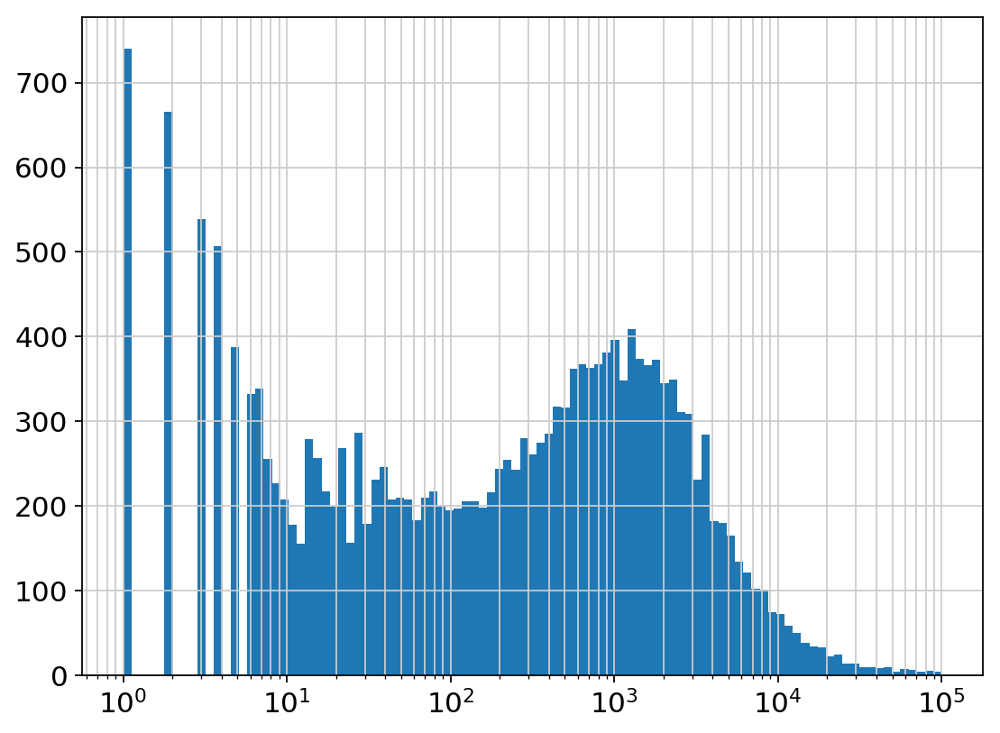

In [100]:
plt.figure(figsize=(8,6))
plt.hist(acg_t.var['n_counts'].values, bins=np.logspace(np.log10(1),np.log10(1e5), 100))
plt.grid(False)
plt.grid(True, 'both', 'both')
plt.xscale('log')
# plt.yscale('log')

In [101]:
# remove any genes that are now empty
sc.pp.filter_genes(acg_t, min_counts=20, inplace=True)
sc.pp.normalize_per_cell(acg_t, counts_per_cell_after=1e6)
sc.pp.log1p(acg_t)

filtered out 6194 genes that are detected in less than 20 counts
normalizing by total count per cell
    finished (0:00:00): normalized adata.X and added    'n_counts', counts per cell before normalization (adata.obs)


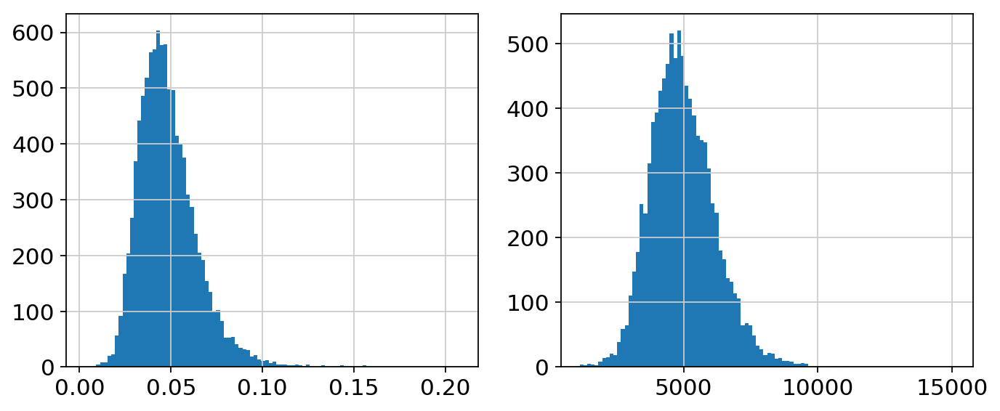

In [102]:
fig, ax = plt.subplots(1,2,figsize=(10,4))
for vals, ax in zip(['percent_mito','n_counts'], np.ravel(ax)):
    ax.hist(acg_t.obs[vals].values,bins=100)

In [103]:
sc.pp.scale(acg_t)
sc.pp.combat(acg_t, key='batch',covariates=['cond','free_id'])
sc.pp.scale(acg_t)
sc.pp.pca(acg_t, n_comps=200)

    ... scale_data: as `zero_center=True`, sparse input is densified and may lead to large memory consumption.


... storing 'DROPLET.TYPE' as categorical
... storing 'cond' as categorical
... storing 'exp_id' as categorical
... storing 'free_id' as categorical
... storing 'pool_code' as categorical
... storing 'feature_types' as categorical
... storing 'genome' as categorical


Standardizing Data across genes.

Found 12 batches

Found 2 categorical variables:
	cond, free_id

Found 0 numerical variables:
	

Fitting L/S model and finding priors

Finding parametric adjustments

Adjusting data

computing PCA with n_comps = 200
    finished (0:02:07)
    and added
    'X_pca', the PCA coordinates (adata.obs)
    'PC1', 'PC2', ..., the loadings (adata.var)
    'pca_variance', the variance / eigenvalues (adata.uns)
    'pca_variance_ratio', the variance ratio (adata.uns)


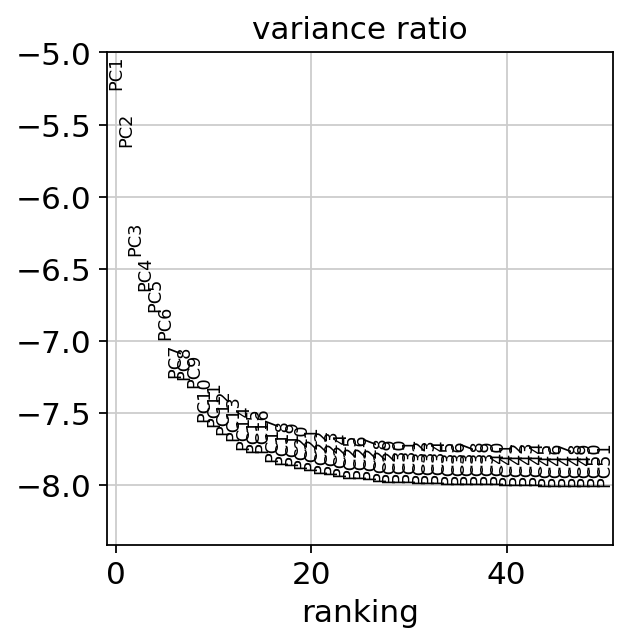

In [105]:
sc.pl.pca_variance_ratio(acg_t,log=True, n_pcs=50)

In [106]:
df_loadings = pd.DataFrame(acg_t.varm['PCs'], index=acg_t.var_names)
df_rankings = pd.DataFrame((-1 * df_loadings.values).argsort(0).argsort(0), index=df_loadings.index, columns=df_loadings.columns)

In [107]:
num = 50
percent_ribos = dict()
percent_mitos = dict()
for direction, boolean in zip(['corr', 'anti-corr'], [False, True]):
    percent_ribos[direction] = list()
    percent_mitos[direction] = list()
    for pc in range(200):
        top_genes = df_loadings[pc].sort_values(ascending=boolean)[:num].index
        percent_ribos[direction].append(len([i for i in top_genes if i.startswith('RP')])/num)
        percent_mitos[direction].append(len([i for i in top_genes if i.startswith('MT')])/num)

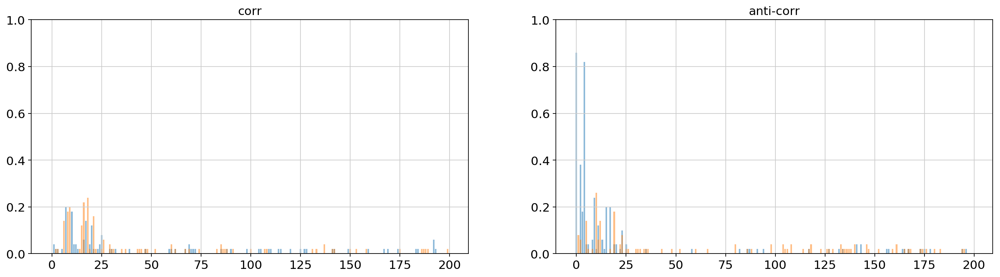

In [108]:
fig, ax = plt.subplots(1, 2, figsize=(20, 5))
for direction, ax in zip(['corr', 'anti-corr'], ax):
    ax.bar(range(len(percent_ribos[direction])), percent_ribos[direction], alpha=0.5)
    ax.bar(range(len(percent_mitos[direction])), percent_mitos[direction], alpha=0.5)
    ax.set_title(direction)
    ax.set_ylim((0, 1))

In [109]:
acg_t.obs['ribo_pc_1'] = acg_t.obsm['X_pca'][:,0]
acg_t.obs['ribo_pc_2'] = acg_t.obsm['X_pca'][:,4]

In [110]:
warnings.filterwarnings('ignore')
sc.pp.regress_out(acg_t, ['ribo_pc_1','ribo_pc_2'], n_jobs=1)
warnings.filterwarnings('default')

regressing out ['ribo_pc_1', 'ribo_pc_2']
    finished (0:01:57)


In [111]:
sc.pp.scale(acg_t)
sc.pp.pca(acg_t, n_comps=200)

computing PCA with n_comps = 200
    finished (0:02:06)
    and added
    'X_pca', the PCA coordinates (adata.obs)
    'PC1', 'PC2', ..., the loadings (adata.var)
    'pca_variance', the variance / eigenvalues (adata.uns)
    'pca_variance_ratio', the variance ratio (adata.uns)


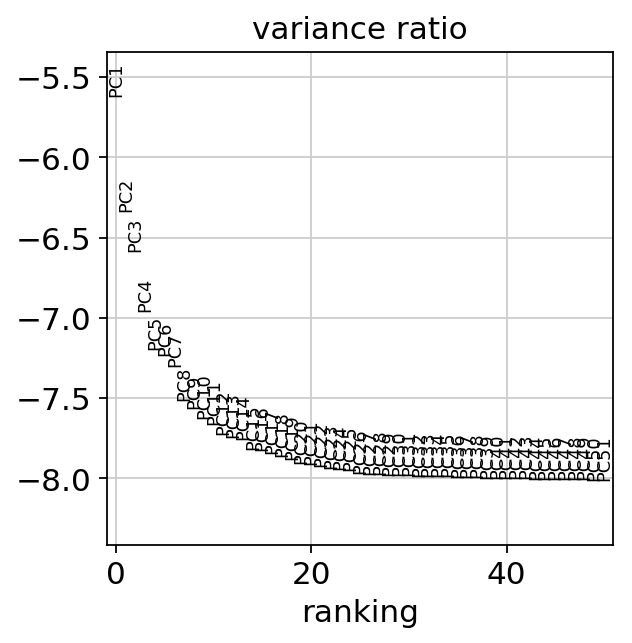

In [112]:
sc.pl.pca_variance_ratio(acg_t,log=True, n_pcs=50)

In [113]:
df_loadings = pd.DataFrame(acg_t.varm['PCs'], index=acg_t.var_names)
df_rankings = pd.DataFrame((-1 * df_loadings.values).argsort(0).argsort(0), index=df_loadings.index, columns=df_loadings.columns)

In [114]:
num = 50
percent_ribos = dict()
percent_mitos = dict()
for direction, boolean in zip(['corr', 'anti-corr'], [False, True]):
    percent_ribos[direction] = list()
    percent_mitos[direction] = list()
    for pc in range(200):
        top_genes = df_loadings[pc].sort_values(ascending=boolean)[:num].index
        percent_ribos[direction].append(len([i for i in top_genes if i.startswith('RP')])/num)
        percent_mitos[direction].append(len([i for i in top_genes if i.startswith('MT')])/num)

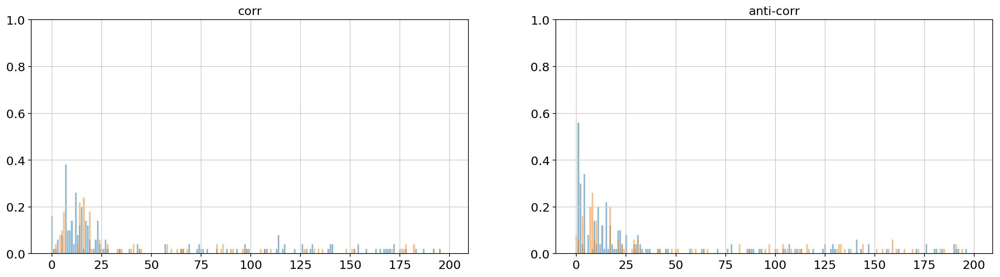

In [115]:
fig, ax = plt.subplots(1, 2, figsize=(20, 5))
for direction, ax in zip(['corr', 'anti-corr'], ax):
    ax.bar(range(len(percent_ribos[direction])), percent_ribos[direction], alpha=0.5)
    ax.bar(range(len(percent_mitos[direction])), percent_mitos[direction], alpha=0.5)
    ax.set_title(direction)
    ax.set_ylim((0, 1))

In [116]:
warnings.filterwarnings('ignore')
sc.pp.neighbors(acg_t,n_neighbors=15,n_pcs=40)
warnings.filterwarnings('default')

computing neighbors
    computing neighbors
    using 'X_pca' with n_pcs = 40
    computed neighbors (0:00:03)
    computed connectivities (0:00:00)
    finished: added to `.uns['neighbors']`
    'distances', distances for each pair of neighbors
    'connectivities', weighted adjacency matrix (0:00:04)


In [117]:
sc.tl.umap(acg_t)

computing UMAP
	completed  0  /  500 epochs
	completed  50  /  500 epochs
	completed  100  /  500 epochs
	completed  150  /  500 epochs
	completed  200  /  500 epochs
	completed  250  /  500 epochs
	completed  300  /  500 epochs
	completed  350  /  500 epochs
	completed  400  /  500 epochs
	completed  450  /  500 epochs
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:25)


In [237]:
sc.tl.leiden(acg_t, resolution=1)

running Leiden clustering
    finished: found 11 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:03)


# Visualization

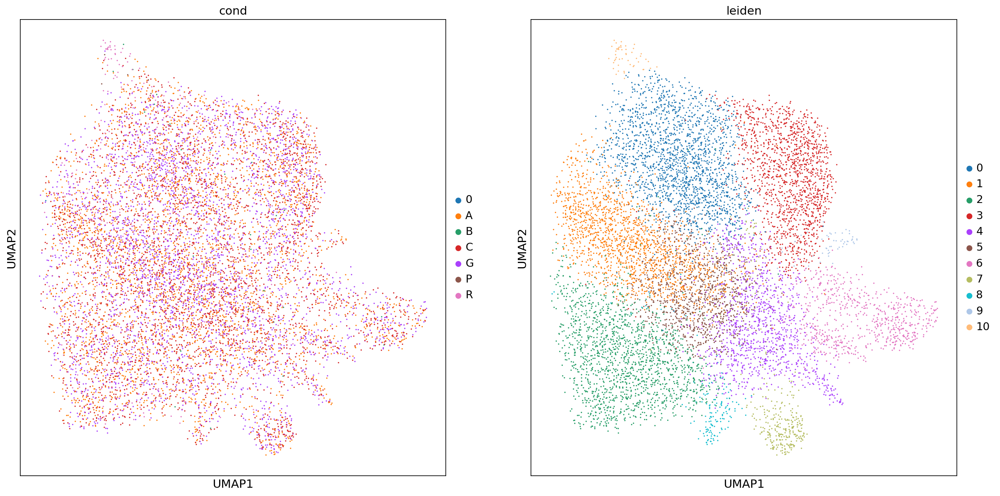

In [238]:
fig, ax = plt.subplots(1, 2, figsize=(20,10))
for color, ax, palette in zip(['cond', 'leiden'], ax, [None, sc.pl.palettes.default_20]):
    sc.pl.umap(acg_t,color=color, ax=ax, show=False, return_fig=False, size=10, palette=palette)

In [239]:
def add_raw(adata, transformed=True):
    path = prefix + 'pkls/aggr/wells.sng.w_covars.pkl'
    
    with open(path,'rb') as file:
        wells = pkl.load(file)
    
    for well in wells:
        wells[well]['adata'].obs_names = [i[:16] + '-%s' % well for i in wells[well]['adata'].obs_names]
    
    raw = wells[0]['adata'].concatenate(*[wells[i]['adata'] for  i in range(1, 12)])[adata.obs_names,:]
    
    if transformed == True:
        sc.pp.normalize_per_cell(raw,counts_per_cell_after=1e6)
        sc.pp.log1p(raw)
    
    adata.raw = raw
    return

In [240]:
add_raw(acg_t)

normalizing by total count per cell


Trying to set attribute `.obs` of view, copying.


    finished (0:00:00): normalized adata.X and added    'n_counts', counts per cell before normalization (adata.obs)


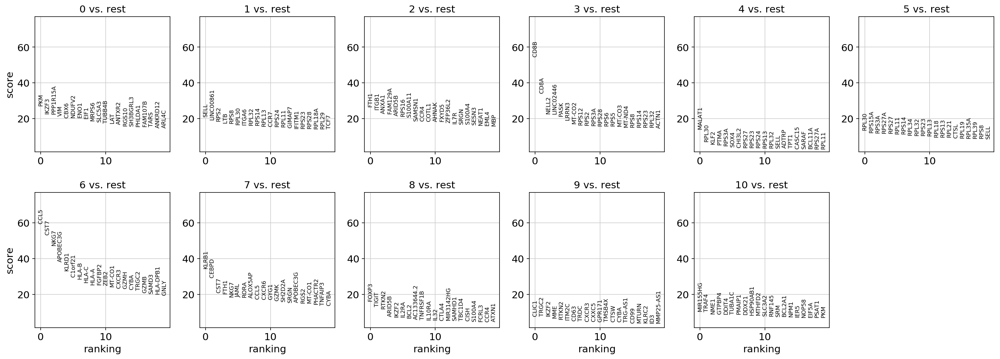

In [241]:
sc.settings.verbosity = 0
warnings.filterwarnings('ignore')
sc.tl.rank_genes_groups(acg_t, groupby='leiden', n_genes=100, use_raw=True)
warnings.filterwarnings('default')
sc.pl.rank_genes_groups(acg_t, ncols=6, n_genes=20)
sc.settings.verbosity = 4

In [ ]:
path = '/data/codec/production.run/adts/pkls/combat/concat.combat.adts.norm.log.pkl'
with open(path,'rb') as file:
    concat_adts = pkl.load(file)
transcripts = acg_t.var_names
proteins = concat_adts['adata'].var_names
adts_df = pd.DataFrame(concat_adts['adata'].X, columns=proteins, index=concat_adts['adata'].obs_names)
acg_t.obs = acg_t.obs.join(adts_df)

In [243]:
features = ['CD8|CD8A','CD8A','CD4|CD4','CD4']

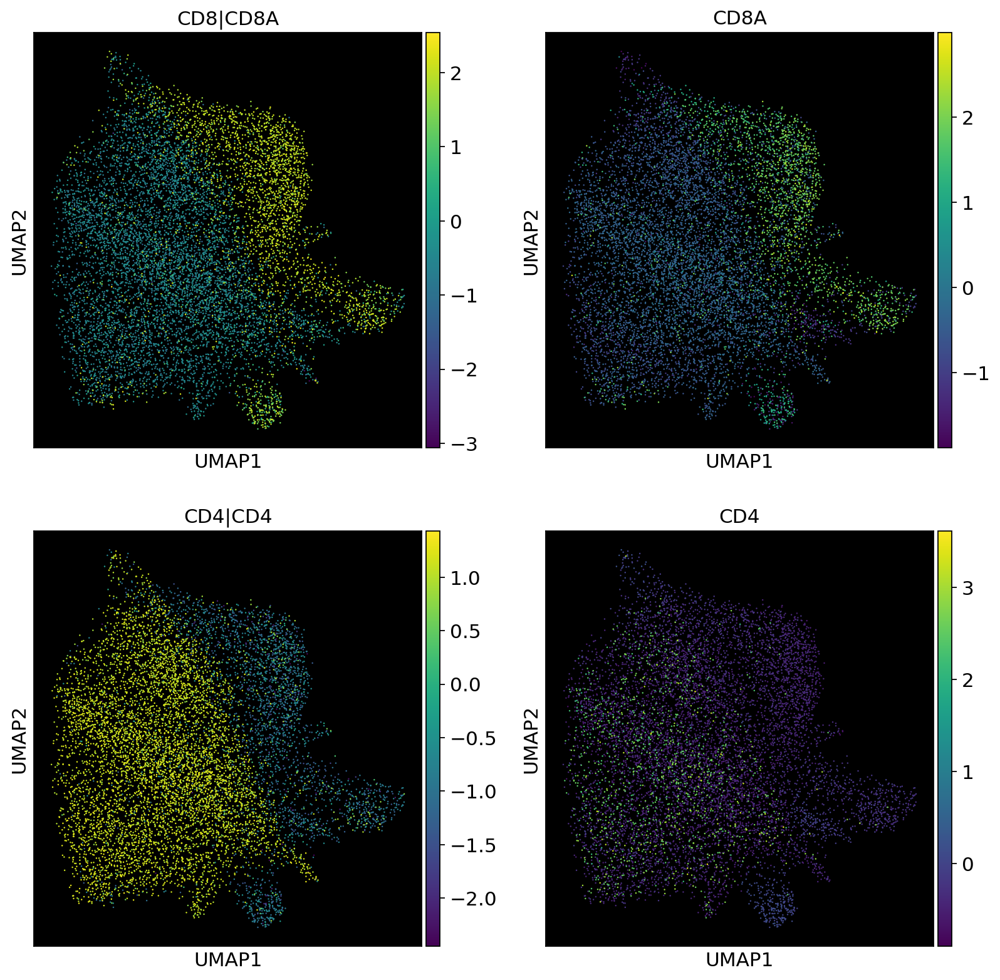

In [244]:
fig, ax = plt.subplots(2,2,figsize=(12,12))
for ax, f in zip(np.ravel(ax), features):
    ax.set_facecolor('black')
    sc.pl.umap(acg_t, color=f, ax=ax,show=False, return_fig=False, size=5, use_raw=False)

# RUN 4

In [245]:
acg_t_cells = np.random.choice(acg_t_cells, size=10000, replace=False)

In [246]:
for well in wells:
    wells[well]['adata'].obs_names = [i[:16] + '-%s' % well for i in wells[well]['adata'].obs_names]

In [247]:
acg_t = wells[0]['adata'].concatenate(*[wells[i]['adata'] for  i in range(1, 12)])[acg_t_cells].copy()

In [248]:
acg_t.var['n_counts'] = acg_t.X.toarray().sum(axis=0)

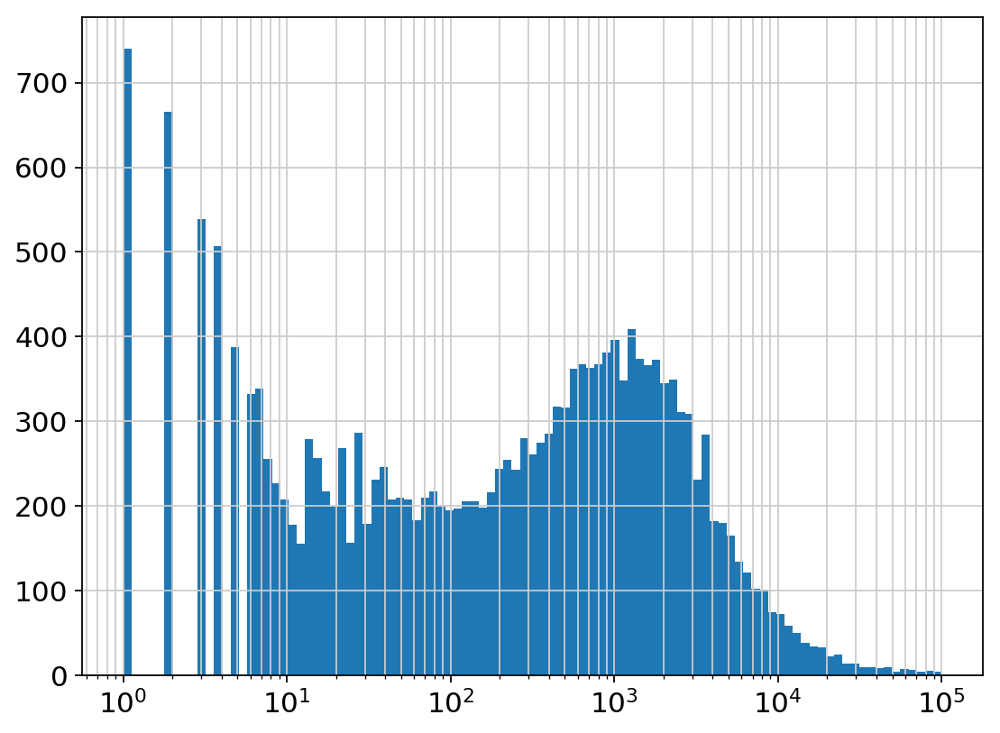

In [249]:
plt.figure(figsize=(8,6))
plt.hist(acg_t.var['n_counts'].values, bins=np.logspace(np.log10(1),np.log10(1e5), 100))
plt.grid(False)
plt.grid(True, 'both', 'both')
plt.xscale('log')
# plt.yscale('log')

In [250]:
# remove any genes that are now empty
sc.pp.filter_genes(acg_t, min_counts=150, inplace=True)
sc.pp.normalize_per_cell(acg_t, counts_per_cell_after=1e6)
sc.pp.log1p(acg_t)

filtered out 9911 genes that are detected in less than 150 counts
normalizing by total count per cell
    finished (0:00:00): normalized adata.X and added    'n_counts', counts per cell before normalization (adata.obs)


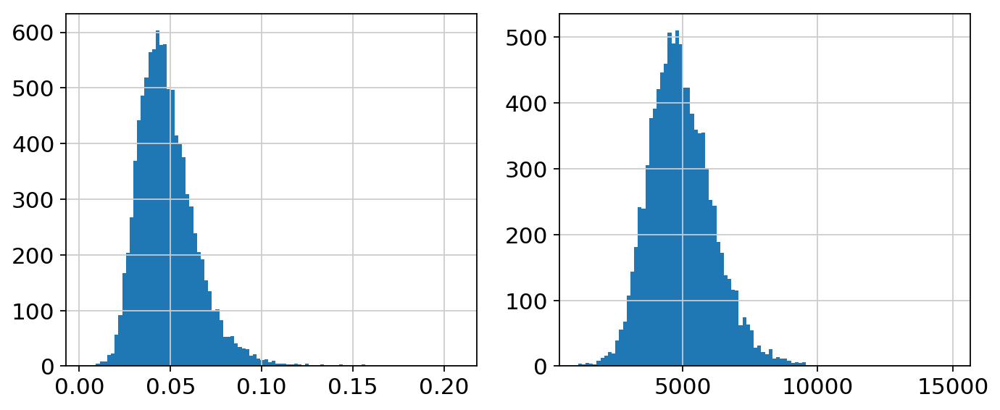

In [251]:
fig, ax = plt.subplots(1,2,figsize=(10,4))
for vals, ax in zip(['percent_mito','n_counts'], np.ravel(ax)):
    ax.hist(acg_t.obs[vals].values,bins=100)

In [252]:
sc.pp.scale(acg_t)
sc.pp.combat(acg_t, key='batch',covariates=['cond','free_id'])
sc.pp.scale(acg_t)
sc.pp.pca(acg_t, n_comps=100)

    ... scale_data: as `zero_center=True`, sparse input is densified and may lead to large memory consumption.


... storing 'DROPLET.TYPE' as categorical
... storing 'cond' as categorical
... storing 'exp_id' as categorical
... storing 'free_id' as categorical
... storing 'pool_code' as categorical
... storing 'feature_types' as categorical
... storing 'genome' as categorical


Standardizing Data across genes.

Found 12 batches

Found 2 categorical variables:
	cond, free_id

Found 0 numerical variables:
	

Fitting L/S model and finding priors

Finding parametric adjustments

Adjusting data

computing PCA with n_comps = 100
    finished (0:00:56)
    and added
    'X_pca', the PCA coordinates (adata.obs)
    'PC1', 'PC2', ..., the loadings (adata.var)
    'pca_variance', the variance / eigenvalues (adata.uns)
    'pca_variance_ratio', the variance ratio (adata.uns)


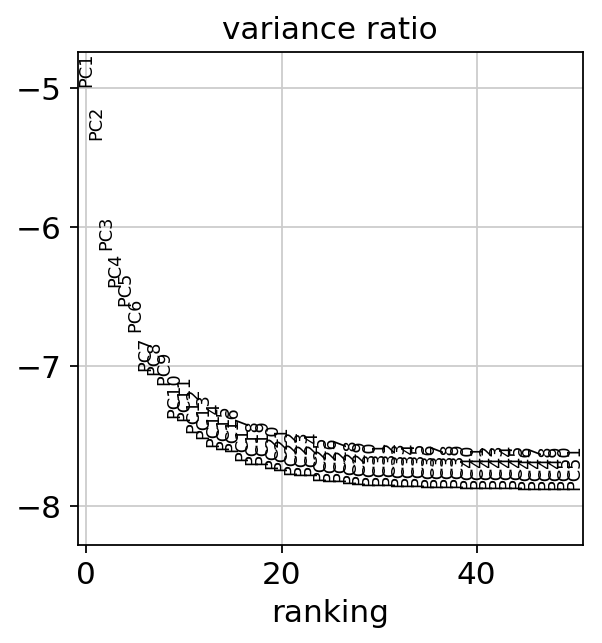

In [253]:
sc.pl.pca_variance_ratio(acg_t,log=True, n_pcs=50)

In [254]:
df_loadings = pd.DataFrame(acg_t.varm['PCs'], index=acg_t.var_names)
df_rankings = pd.DataFrame((-1 * df_loadings.values).argsort(0).argsort(0), index=df_loadings.index, columns=df_loadings.columns)

In [256]:
num = 50
percent_ribos = dict()
percent_mitos = dict()
for direction, boolean in zip(['corr', 'anti-corr'], [False, True]):
    percent_ribos[direction] = list()
    percent_mitos[direction] = list()
    for pc in range(100):
        top_genes = df_loadings[pc].sort_values(ascending=boolean)[:num].index
        percent_ribos[direction].append(len([i for i in top_genes if i.startswith('RP')])/num)
        percent_mitos[direction].append(len([i for i in top_genes if i.startswith('MT')])/num)

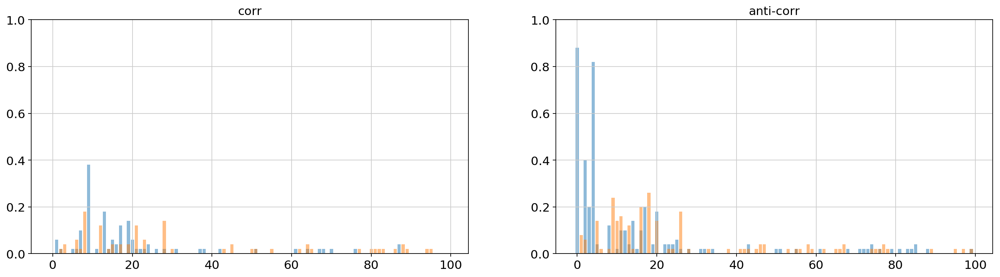

In [257]:
fig, ax = plt.subplots(1, 2, figsize=(20, 5))
for direction, ax in zip(['corr', 'anti-corr'], ax):
    ax.bar(range(len(percent_ribos[direction])), percent_ribos[direction], alpha=0.5)
    ax.bar(range(len(percent_mitos[direction])), percent_mitos[direction], alpha=0.5)
    ax.set_title(direction)
    ax.set_ylim((0, 1))

In [258]:
acg_t.obs['ribo_pc_1'] = acg_t.obsm['X_pca'][:,0]
acg_t.obs['ribo_pc_2'] = acg_t.obsm['X_pca'][:,4]

In [259]:
warnings.filterwarnings('ignore')
sc.pp.regress_out(acg_t, ['ribo_pc_1','ribo_pc_2'], n_jobs=1)
warnings.filterwarnings('default')

regressing out ['ribo_pc_1', 'ribo_pc_2']
    finished (0:01:28)


In [260]:
sc.pp.scale(acg_t)
sc.pp.pca(acg_t, n_comps=100)

computing PCA with n_comps = 100
    finished (0:00:56)
    and added
    'X_pca', the PCA coordinates (adata.obs)
    'PC1', 'PC2', ..., the loadings (adata.var)
    'pca_variance', the variance / eigenvalues (adata.uns)
    'pca_variance_ratio', the variance ratio (adata.uns)


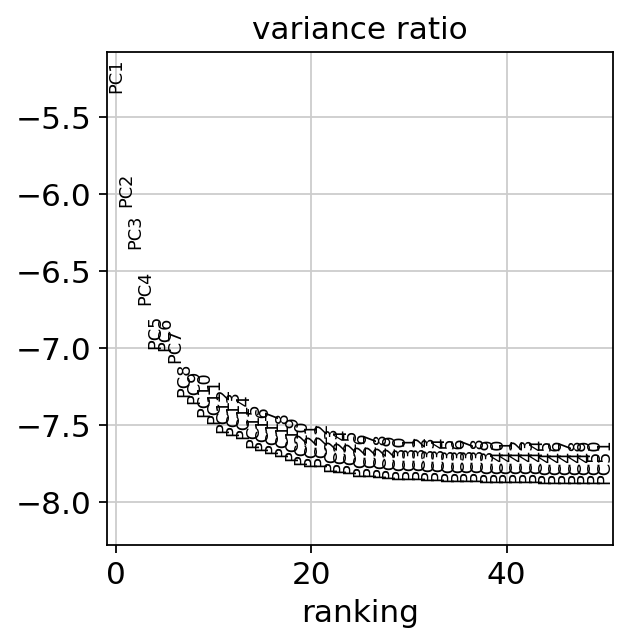

In [261]:
sc.pl.pca_variance_ratio(acg_t,log=True, n_pcs=50)

In [262]:
df_loadings = pd.DataFrame(acg_t.varm['PCs'], index=acg_t.var_names)
df_rankings = pd.DataFrame((-1 * df_loadings.values).argsort(0).argsort(0), index=df_loadings.index, columns=df_loadings.columns)

In [264]:
num = 50
percent_ribos = dict()
percent_mitos = dict()
for direction, boolean in zip(['corr', 'anti-corr'], [False, True]):
    percent_ribos[direction] = list()
    percent_mitos[direction] = list()
    for pc in range(100):
        top_genes = df_loadings[pc].sort_values(ascending=boolean)[:num].index
        percent_ribos[direction].append(len([i for i in top_genes if i.startswith('RP')])/num)
        percent_mitos[direction].append(len([i for i in top_genes if i.startswith('MT')])/num)

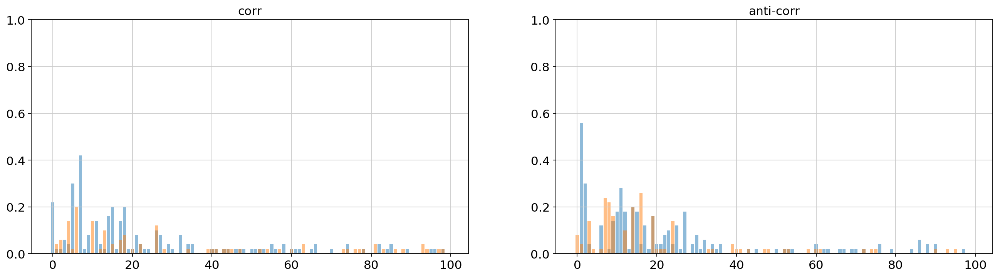

In [265]:
fig, ax = plt.subplots(1, 2, figsize=(20, 5))
for direction, ax in zip(['corr', 'anti-corr'], ax):
    ax.bar(range(len(percent_ribos[direction])), percent_ribos[direction], alpha=0.5)
    ax.bar(range(len(percent_mitos[direction])), percent_mitos[direction], alpha=0.5)
    ax.set_title(direction)
    ax.set_ylim((0, 1))

In [266]:
warnings.filterwarnings('ignore')
sc.pp.neighbors(acg_t,n_neighbors=15,n_pcs=40)
warnings.filterwarnings('default')

computing neighbors
    computing neighbors
    using 'X_pca' with n_pcs = 40
    computed neighbors (0:00:03)
    computed connectivities (0:00:00)
    finished: added to `.uns['neighbors']`
    'distances', distances for each pair of neighbors
    'connectivities', weighted adjacency matrix (0:00:04)


In [267]:
sc.tl.umap(acg_t)

computing UMAP
	completed  0  /  500 epochs
	completed  50  /  500 epochs
	completed  100  /  500 epochs
	completed  150  /  500 epochs
	completed  200  /  500 epochs
	completed  250  /  500 epochs
	completed  300  /  500 epochs
	completed  350  /  500 epochs
	completed  400  /  500 epochs
	completed  450  /  500 epochs
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:25)


In [268]:
sc.tl.leiden(acg_t, resolution=1)

running Leiden clustering
    finished: found 10 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:04)


# Visualization

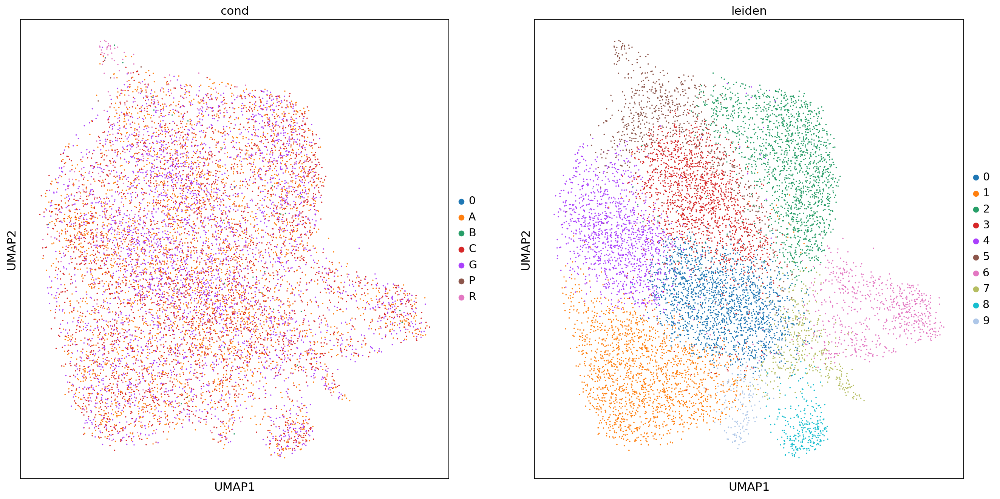

In [269]:
fig, ax = plt.subplots(1, 2, figsize=(20,10))
for color, ax, palette in zip(['cond', 'leiden'], ax, [None, sc.pl.palettes.default_20]):
    sc.pl.umap(acg_t,color=color, ax=ax, show=False, return_fig=False, size=10, palette=palette)

In [270]:
def add_raw(adata, transformed=True):
    path = prefix + 'pkls/aggr/wells.sng.w_covars.pkl'
    
    with open(path,'rb') as file:
        wells = pkl.load(file)
    
    for well in wells:
        wells[well]['adata'].obs_names = [i[:16] + '-%s' % well for i in wells[well]['adata'].obs_names]
    
    raw = wells[0]['adata'].concatenate(*[wells[i]['adata'] for  i in range(1, 12)])[adata.obs_names,:]
    
    if transformed == True:
        sc.pp.normalize_per_cell(raw,counts_per_cell_after=1e6)
        sc.pp.log1p(raw)
    
    adata.raw = raw
    return

In [271]:
add_raw(acg_t)

normalizing by total count per cell


Trying to set attribute `.obs` of view, copying.


    finished (0:00:00): normalized adata.X and added    'n_counts', counts per cell before normalization (adata.obs)


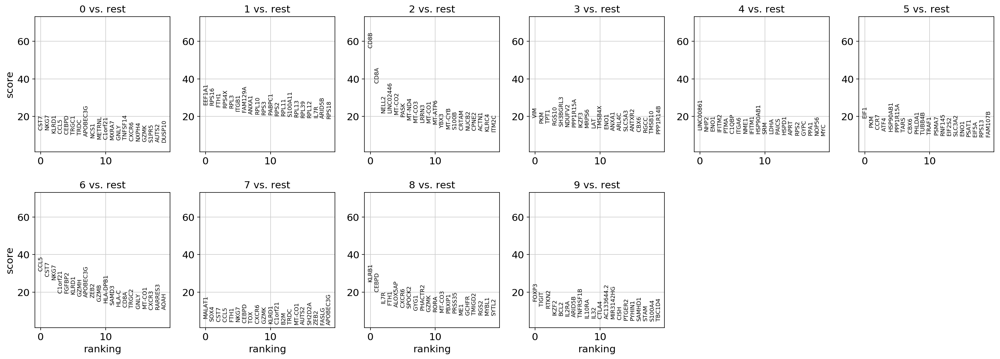

In [279]:
sc.settings.verbosity = 0
warnings.filterwarnings('ignore')
sc.tl.rank_genes_groups(acg_t, groupby='leiden', n_genes=100, use_raw=False)
warnings.filterwarnings('default')
sc.pl.rank_genes_groups(acg_t, ncols=6, n_genes=20)
sc.settings.verbosity = 4

In [273]:
path = '/data/codec/production.run/adts/pkls/combat/concat.combat.adts.norm.log.pkl'
with open(path,'rb') as file:
    concat_adts = pkl.load(file)
transcripts = acg_t.var_names
proteins = concat_adts['adata'].var_names
adts_df = pd.DataFrame(concat_adts['adata'].X, columns=proteins, index=concat_adts['adata'].obs_names)
acg_t.obs = acg_t.obs.join(adts_df)

In [333]:
features = ['CD8|CD8A','CD8A','CD4|CD4','CD4',
           'TRDC', 'CD94|KLRD1','FOXP3','CCR4',
           'CD185|CXCR5', 'CD62L|SELL','CXCR3','CCR6',
           'CD26|DPP4','CCR7','CCL5','CD103|ITGAE']

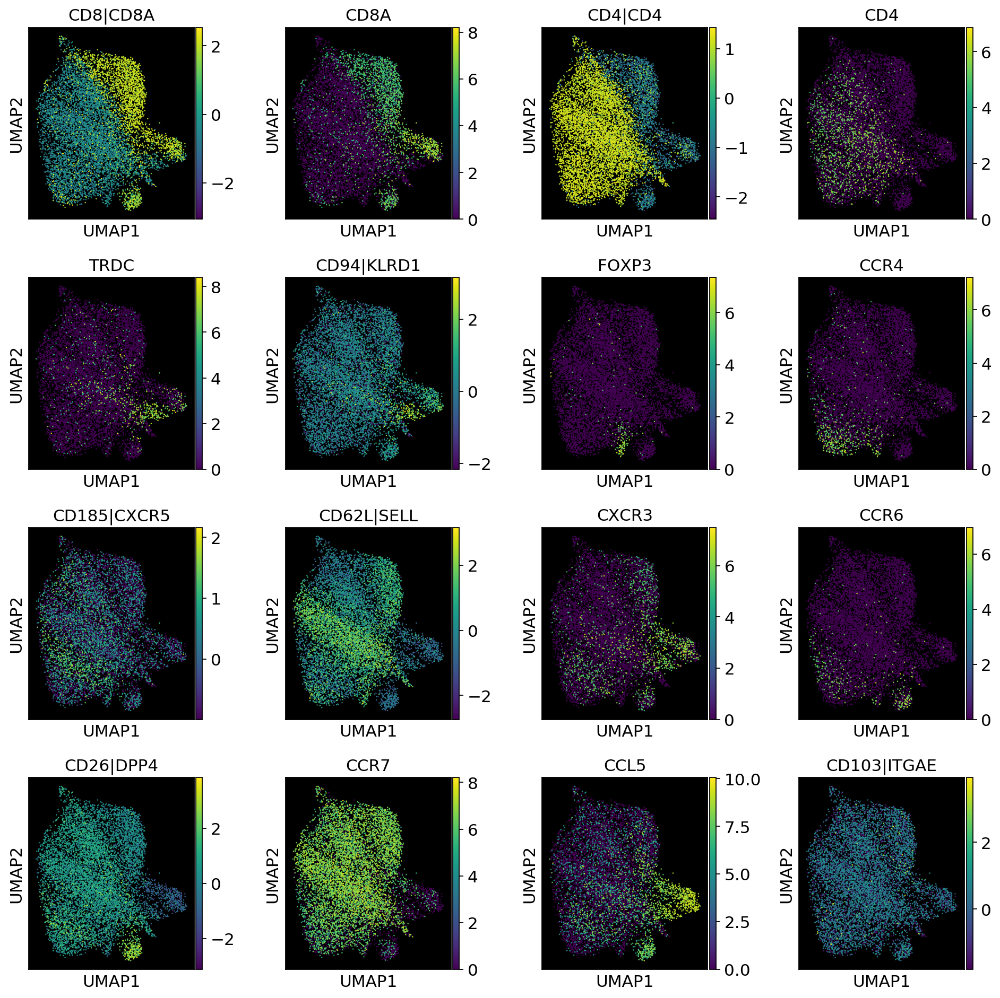

In [335]:
fig, ax = plt.subplots(4,4,figsize=(12,12))
for ax, f in zip(np.ravel(ax), features):
    ax.set_facecolor('black')
    sc.pl.umap(acg_t, color=f, ax=ax,show=False, return_fig=False, size=5, use_raw=True)
plt.tight_layout()

# RUN 5

In [336]:
acg_t_cells = np.random.choice(acg_t_cells, size=10000, replace=False)

In [337]:
for well in wells:
    wells[well]['adata'].obs_names = [i[:16] + '-%s' % well for i in wells[well]['adata'].obs_names]

In [338]:
acg_t = wells[0]['adata'].concatenate(*[wells[i]['adata'] for  i in range(1, 12)])[acg_t_cells].copy()

In [339]:
acg_t.var['n_counts'] = acg_t.X.toarray().sum(axis=0)

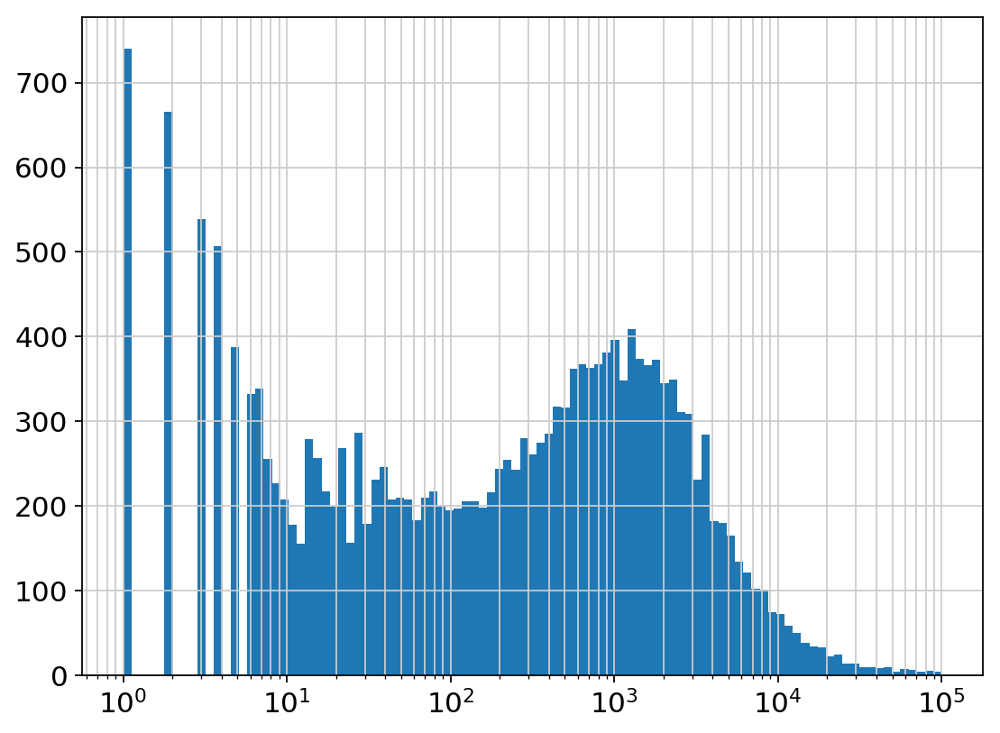

In [340]:
plt.figure(figsize=(8,6))
plt.hist(acg_t.var['n_counts'].values, bins=np.logspace(np.log10(1),np.log10(1e5), 100))
plt.grid(False)
plt.grid(True, 'both', 'both')
plt.xscale('log')
# plt.yscale('log')

In [341]:
# remove any genes that are now empty
sc.pp.filter_genes(acg_t, min_counts=150, inplace=True)
sc.pp.normalize_per_cell(acg_t, counts_per_cell_after=1e6)
sc.pp.log1p(acg_t)

filtered out 9911 genes that are detected in less than 150 counts
normalizing by total count per cell
    finished (0:00:00): normalized adata.X and added    'n_counts', counts per cell before normalization (adata.obs)


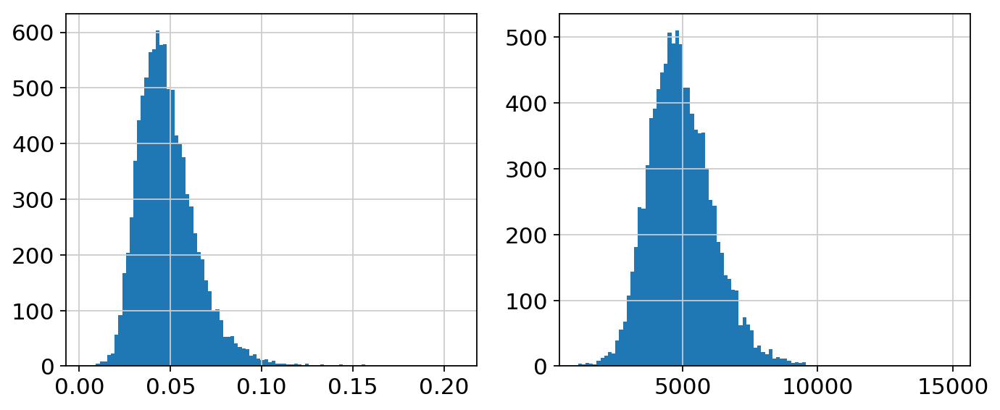

In [342]:
fig, ax = plt.subplots(1,2,figsize=(10,4))
for vals, ax in zip(['percent_mito','n_counts'], np.ravel(ax)):
    ax.hist(acg_t.obs[vals].values,bins=100)

In [343]:
sc.pp.scale(acg_t)
sc.pp.combat(acg_t, key='batch',covariates=['cond','free_id'])
sc.pp.scale(acg_t)
sc.pp.pca(acg_t, n_comps=100)

    ... scale_data: as `zero_center=True`, sparse input is densified and may lead to large memory consumption.


... storing 'DROPLET.TYPE' as categorical
... storing 'cond' as categorical
... storing 'exp_id' as categorical
... storing 'free_id' as categorical
... storing 'pool_code' as categorical
... storing 'feature_types' as categorical
... storing 'genome' as categorical


Standardizing Data across genes.

Found 12 batches

Found 2 categorical variables:
	cond, free_id

Found 0 numerical variables:
	

Fitting L/S model and finding priors

Finding parametric adjustments

Adjusting data

computing PCA with n_comps = 100
    finished (0:00:57)
    and added
    'X_pca', the PCA coordinates (adata.obs)
    'PC1', 'PC2', ..., the loadings (adata.var)
    'pca_variance', the variance / eigenvalues (adata.uns)
    'pca_variance_ratio', the variance ratio (adata.uns)


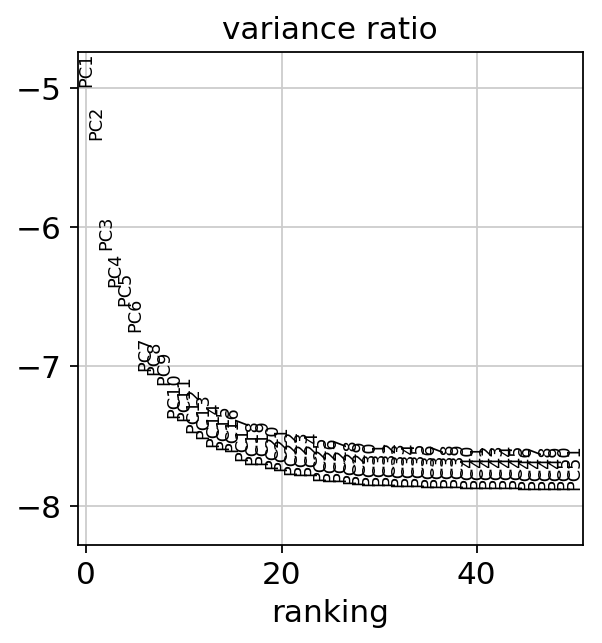

In [344]:
sc.pl.pca_variance_ratio(acg_t,log=True, n_pcs=50)

In [345]:
df_loadings = pd.DataFrame(acg_t.varm['PCs'], index=acg_t.var_names)
df_rankings = pd.DataFrame((-1 * df_loadings.values).argsort(0).argsort(0), index=df_loadings.index, columns=df_loadings.columns)

In [346]:
num = 50
percent_ribos = dict()
percent_mitos = dict()
for direction, boolean in zip(['corr', 'anti-corr'], [False, True]):
    percent_ribos[direction] = list()
    percent_mitos[direction] = list()
    for pc in range(100):
        top_genes = df_loadings[pc].sort_values(ascending=boolean)[:num].index
        percent_ribos[direction].append(len([i for i in top_genes if i.startswith('RP')])/num)
        percent_mitos[direction].append(len([i for i in top_genes if i.startswith('MT')])/num)

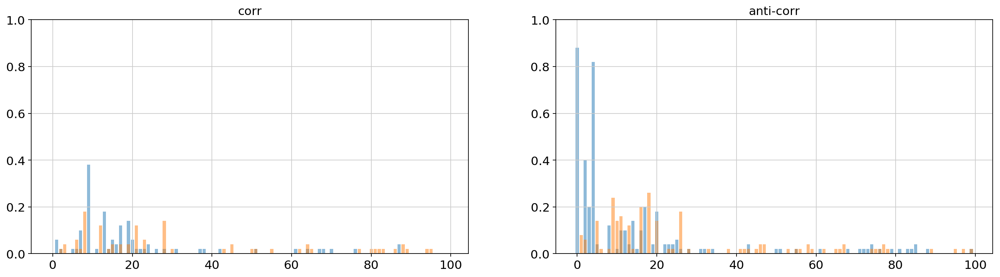

In [347]:
fig, ax = plt.subplots(1, 2, figsize=(20, 5))
for direction, ax in zip(['corr', 'anti-corr'], ax):
    ax.bar(range(len(percent_ribos[direction])), percent_ribos[direction], alpha=0.5)
    ax.bar(range(len(percent_mitos[direction])), percent_mitos[direction], alpha=0.5)
    ax.set_title(direction)
    ax.set_ylim((0, 1))

In [348]:
acg_t.obs['ribo_pc_1'] = acg_t.obsm['X_pca'][:,0]
acg_t.obs['ribo_pc_2'] = acg_t.obsm['X_pca'][:,4]

In [349]:
warnings.filterwarnings('ignore')
sc.pp.regress_out(acg_t, ['ribo_pc_1','ribo_pc_2'], n_jobs=1)
warnings.filterwarnings('default')

regressing out ['ribo_pc_1', 'ribo_pc_2']
    finished (0:01:27)


In [350]:
sc.pp.scale(acg_t)
sc.pp.pca(acg_t, n_comps=100)

computing PCA with n_comps = 100
    finished (0:00:56)
    and added
    'X_pca', the PCA coordinates (adata.obs)
    'PC1', 'PC2', ..., the loadings (adata.var)
    'pca_variance', the variance / eigenvalues (adata.uns)
    'pca_variance_ratio', the variance ratio (adata.uns)


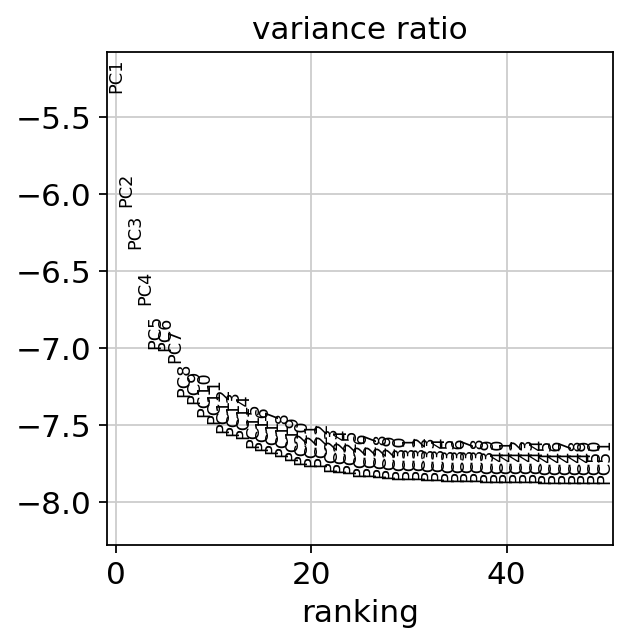

In [351]:
sc.pl.pca_variance_ratio(acg_t,log=True, n_pcs=50)

In [352]:
df_loadings = pd.DataFrame(acg_t.varm['PCs'], index=acg_t.var_names)
df_rankings = pd.DataFrame((-1 * df_loadings.values).argsort(0).argsort(0), index=df_loadings.index, columns=df_loadings.columns)

In [353]:
num = 50
percent_ribos = dict()
percent_mitos = dict()
for direction, boolean in zip(['corr', 'anti-corr'], [False, True]):
    percent_ribos[direction] = list()
    percent_mitos[direction] = list()
    for pc in range(100):
        top_genes = df_loadings[pc].sort_values(ascending=boolean)[:num].index
        percent_ribos[direction].append(len([i for i in top_genes if i.startswith('RP')])/num)
        percent_mitos[direction].append(len([i for i in top_genes if i.startswith('MT')])/num)

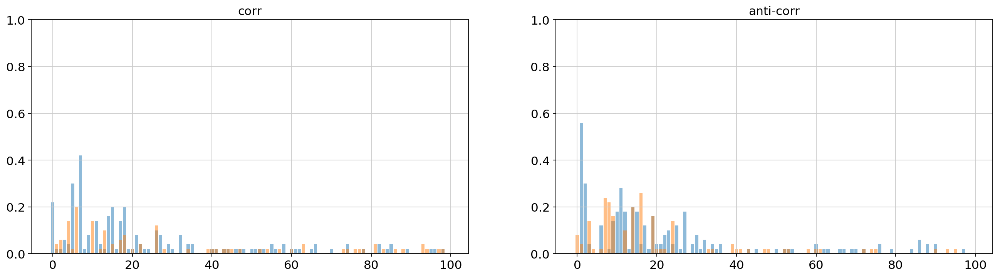

In [354]:
fig, ax = plt.subplots(1, 2, figsize=(20, 5))
for direction, ax in zip(['corr', 'anti-corr'], ax):
    ax.bar(range(len(percent_ribos[direction])), percent_ribos[direction], alpha=0.5)
    ax.bar(range(len(percent_mitos[direction])), percent_mitos[direction], alpha=0.5)
    ax.set_title(direction)
    ax.set_ylim((0, 1))

In [355]:
acg_t.obs['ribo_pc_3'] = acg_t.obsm['X_pca'][:,1]

In [356]:
warnings.filterwarnings('ignore')
sc.pp.regress_out(acg_t, ['ribo_pc_3'], n_jobs=1)
warnings.filterwarnings('default')

regressing out ['ribo_pc_3']
    finished (0:01:16)


In [357]:
sc.pp.scale(acg_t)
sc.pp.pca(acg_t, n_comps=100)

computing PCA with n_comps = 100
    finished (0:00:58)
    and added
    'X_pca', the PCA coordinates (adata.obs)
    'PC1', 'PC2', ..., the loadings (adata.var)
    'pca_variance', the variance / eigenvalues (adata.uns)
    'pca_variance_ratio', the variance ratio (adata.uns)


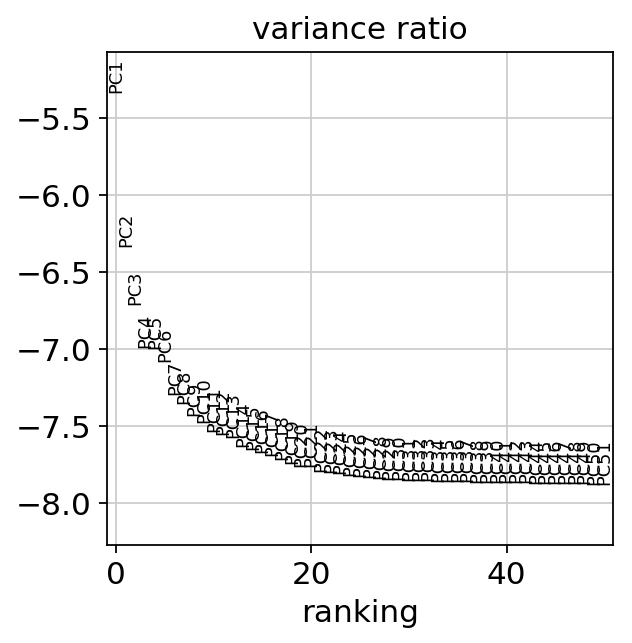

In [358]:
sc.pl.pca_variance_ratio(acg_t,log=True, n_pcs=50)

In [359]:
df_loadings = pd.DataFrame(acg_t.varm['PCs'], index=acg_t.var_names)
df_rankings = pd.DataFrame((-1 * df_loadings.values).argsort(0).argsort(0), index=df_loadings.index, columns=df_loadings.columns)

In [360]:
num = 50
percent_ribos = dict()
percent_mitos = dict()
for direction, boolean in zip(['corr', 'anti-corr'], [False, True]):
    percent_ribos[direction] = list()
    percent_mitos[direction] = list()
    for pc in range(100):
        top_genes = df_loadings[pc].sort_values(ascending=boolean)[:num].index
        percent_ribos[direction].append(len([i for i in top_genes if i.startswith('RP')])/num)
        percent_mitos[direction].append(len([i for i in top_genes if i.startswith('MT')])/num)

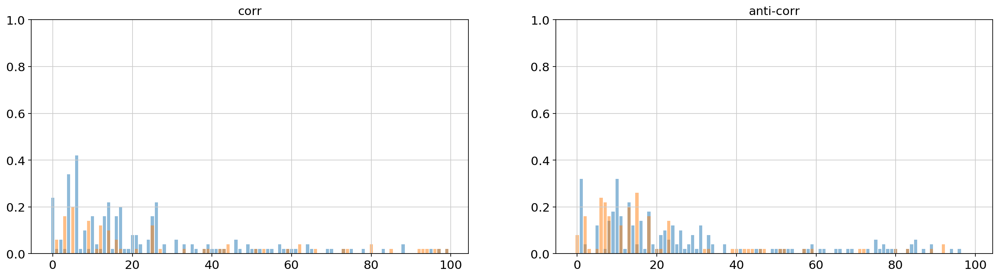

In [361]:
fig, ax = plt.subplots(1, 2, figsize=(20, 5))
for direction, ax in zip(['corr', 'anti-corr'], ax):
    ax.bar(range(len(percent_ribos[direction])), percent_ribos[direction], alpha=0.5)
    ax.bar(range(len(percent_mitos[direction])), percent_mitos[direction], alpha=0.5)
    ax.set_title(direction)
    ax.set_ylim((0, 1))

In [362]:
warnings.filterwarnings('ignore')
sc.pp.neighbors(acg_t,n_neighbors=15,n_pcs=40)
warnings.filterwarnings('default')

computing neighbors
    computing neighbors
    using 'X_pca' with n_pcs = 40
    computed neighbors (0:00:03)
    computed connectivities (0:00:00)
    finished: added to `.uns['neighbors']`
    'distances', distances for each pair of neighbors
    'connectivities', weighted adjacency matrix (0:00:04)


In [363]:
sc.tl.umap(acg_t)

computing UMAP
	completed  0  /  500 epochs
	completed  50  /  500 epochs
	completed  100  /  500 epochs
	completed  150  /  500 epochs
	completed  200  /  500 epochs
	completed  250  /  500 epochs
	completed  300  /  500 epochs
	completed  350  /  500 epochs
	completed  400  /  500 epochs
	completed  450  /  500 epochs
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:25)


In [372]:
sc.tl.leiden(acg_t, resolution=1)

running Leiden clustering
    finished: found 11 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:05)


# Visualization

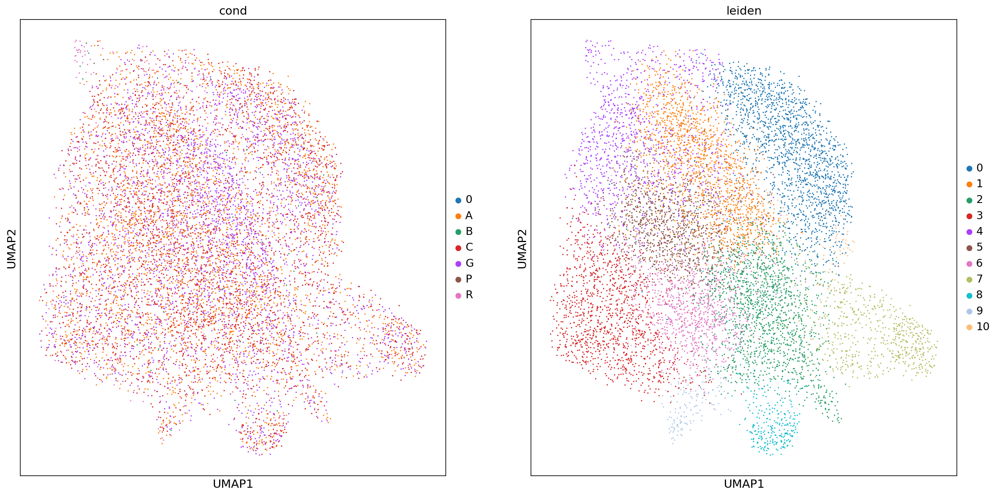

In [373]:
fig, ax = plt.subplots(1, 2, figsize=(20,10))
for color, ax, palette in zip(['cond', 'leiden'], ax, [None, sc.pl.palettes.default_20]):
    sc.pl.umap(acg_t,color=color, ax=ax, show=False, return_fig=False, size=10, palette=palette)

In [374]:
def add_raw(adata, transformed=True):
    path = prefix + 'pkls/aggr/wells.sng.w_covars.pkl'
    
    with open(path,'rb') as file:
        wells = pkl.load(file)
    
    for well in wells:
        wells[well]['adata'].obs_names = [i[:16] + '-%s' % well for i in wells[well]['adata'].obs_names]
    
    raw = wells[0]['adata'].concatenate(*[wells[i]['adata'] for  i in range(1, 12)])[adata.obs_names,:]
    
    if transformed == True:
        sc.pp.normalize_per_cell(raw,counts_per_cell_after=1e6)
        sc.pp.log1p(raw)
    
    adata.raw = raw
    return

In [375]:
add_raw(acg_t)

normalizing by total count per cell


Trying to set attribute `.obs` of view, copying.


    finished (0:00:00): normalized adata.X and added    'n_counts', counts per cell before normalization (adata.obs)


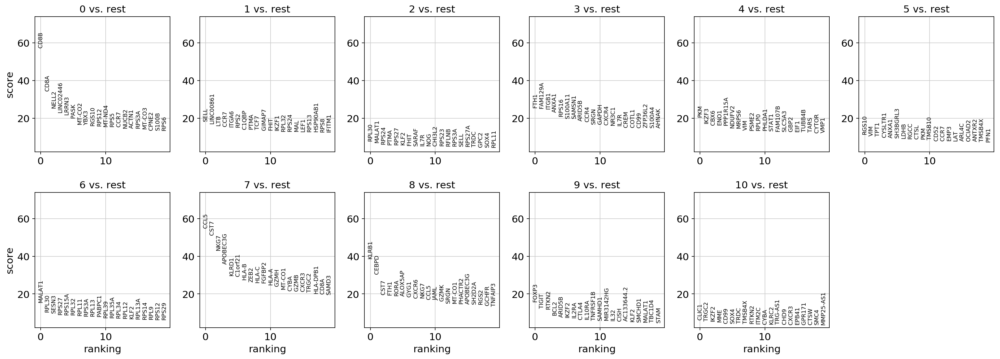

In [380]:
sc.settings.verbosity = 0
warnings.filterwarnings('ignore')
sc.tl.rank_genes_groups(acg_t, groupby='leiden', n_genes=100, use_raw=True)
warnings.filterwarnings('default')
sc.pl.rank_genes_groups(acg_t, ncols=6, n_genes=20)
sc.settings.verbosity = 4

In [377]:
path = '/data/codec/production.run/adts/pkls/combat/concat.combat.adts.norm.log.pkl'
with open(path,'rb') as file:
    concat_adts = pkl.load(file)
transcripts = acg_t.var_names
proteins = concat_adts['adata'].var_names
adts_df = pd.DataFrame(concat_adts['adata'].X, columns=proteins, index=concat_adts['adata'].obs_names)
acg_t.obs = acg_t.obs.join(adts_df)

In [378]:
features = ['CD8|CD8A','CD8A','CD4|CD4','CD4',
           'TRDC', 'CD94|KLRD1','FOXP3','CCR4',
           'CD185|CXCR5', 'CD62L|SELL','CXCR3','CCR6',
           'CD26|DPP4','CCR7','CCL5','CD103|ITGAE']

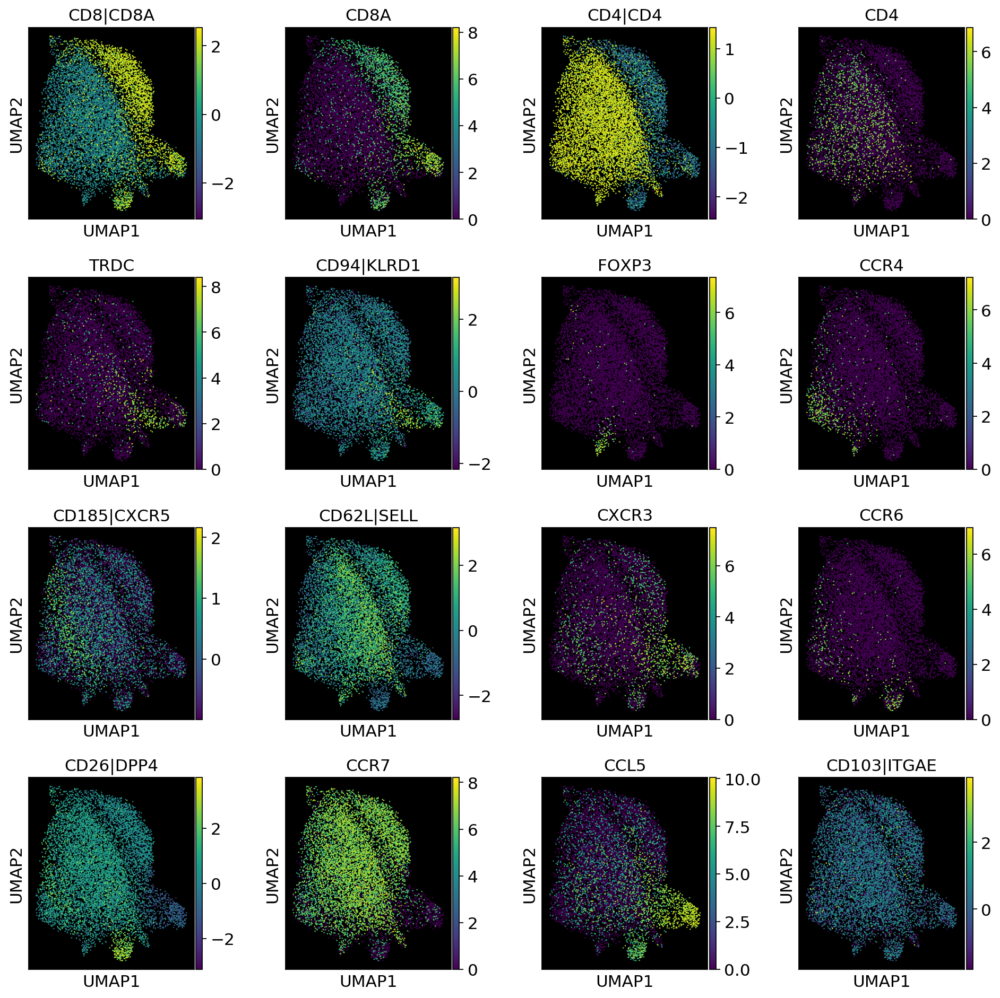

In [379]:
fig, ax = plt.subplots(4,4,figsize=(12,12))
for ax, f in zip(np.ravel(ax), features):
    ax.set_facecolor('black')
    sc.pl.umap(acg_t, color=f, ax=ax,show=False, return_fig=False, size=5, use_raw=True)
plt.tight_layout()

# RUN 6

In [46]:
acg_t_cells = np.random.choice(acg_t_cells, size=10000, replace=False)

In [47]:
for well in wells:
    wells[well]['adata'].obs_names = [i[:16] + '-%s' % well for i in wells[well]['adata'].obs_names]

In [48]:
acg_t = wells[0]['adata'].concatenate(*[wells[i]['adata'] for  i in range(1, 12)])[acg_t_cells].copy()

In [49]:
acg_t.var['n_counts'] = acg_t.X.toarray().sum(axis=0)

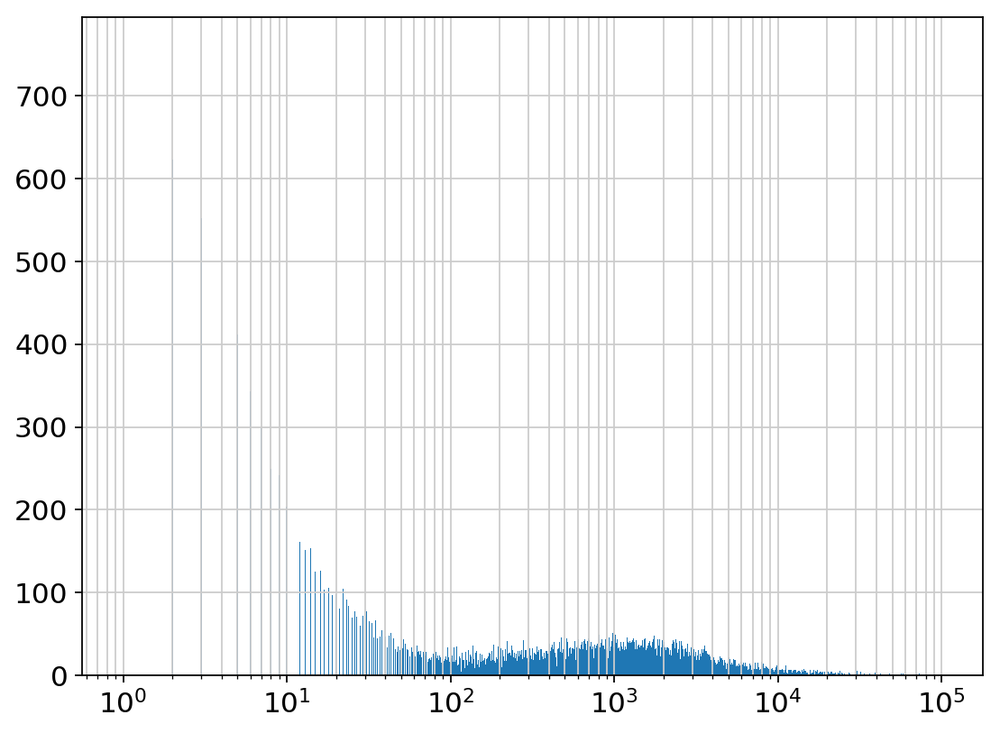

In [50]:
plt.figure(figsize=(8,6))
plt.hist(acg_t.var['n_counts'].values, bins=np.logspace(np.log10(1),np.log10(1e5), 1000))
plt.grid(False)
plt.grid(True, 'both', 'both')
plt.xscale('log')
# plt.yscale('log')

In [51]:
# remove any genes that are now empty
sc.pp.filter_genes(acg_t, min_counts=100, inplace=True)
sc.pp.normalize_per_cell(acg_t, counts_per_cell_after=1e6)
sc.pp.log1p(acg_t)

filtered out 9211 genes that are detected in less than 100 counts
normalizing by total count per cell
    finished (0:00:00): normalized adata.X and added    'n_counts', counts per cell before normalization (adata.obs)


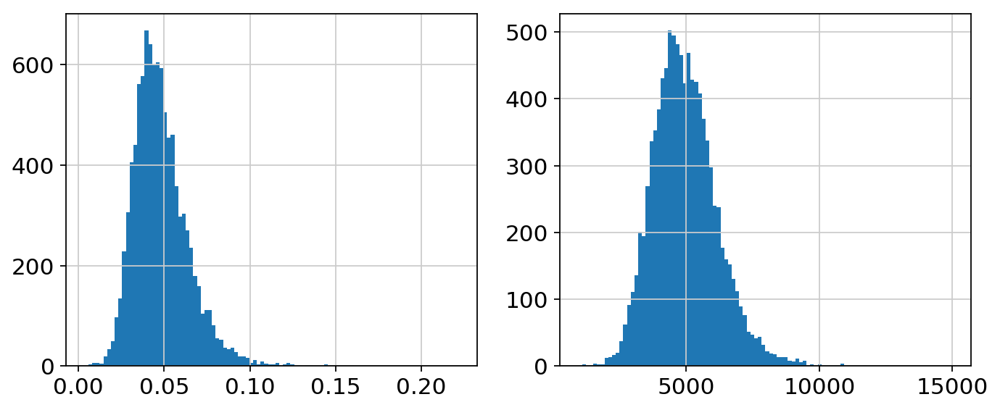

In [52]:
fig, ax = plt.subplots(1,2,figsize=(10,4))
for vals, ax in zip(['percent_mito','n_counts'], np.ravel(ax)):
    ax.hist(acg_t.obs[vals].values,bins=100)

In [53]:
sc.pp.scale(acg_t)
sc.pp.combat(acg_t, key='batch',covariates=['cond','free_id'])
sc.pp.scale(acg_t)
sc.pp.pca(acg_t, n_comps=100)

    ... scale_data: as `zero_center=True`, sparse input is densified and may lead to large memory consumption.


... storing 'DROPLET.TYPE' as categorical
... storing 'cond' as categorical
... storing 'exp_id' as categorical
... storing 'free_id' as categorical
... storing 'pool_code' as categorical
... storing 'feature_types' as categorical
... storing 'genome' as categorical


Standardizing Data across genes.

Found 12 batches

Found 2 categorical variables:
	cond, free_id

Found 0 numerical variables:
	

Fitting L/S model and finding priors

Finding parametric adjustments

Adjusting data

computing PCA with n_comps = 100
    finished (0:01:00)
    and added
    'X_pca', the PCA coordinates (adata.obs)
    'PC1', 'PC2', ..., the loadings (adata.var)
    'pca_variance', the variance / eigenvalues (adata.uns)
    'pca_variance_ratio', the variance ratio (adata.uns)


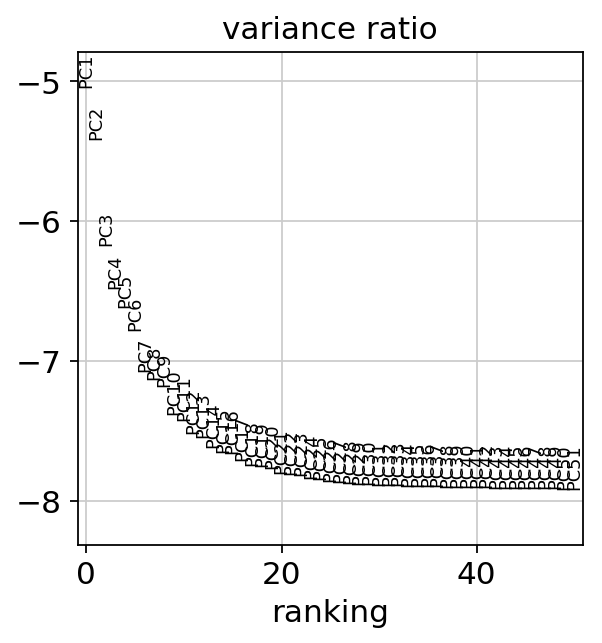

In [54]:
sc.pl.pca_variance_ratio(acg_t,log=True, n_pcs=50)

In [55]:
warnings.filterwarnings('ignore')
sc.pp.neighbors(acg_t,n_neighbors=15,n_pcs=40)
warnings.filterwarnings('default')

computing neighbors
    computing neighbors
    using 'X_pca' with n_pcs = 40
    computed neighbors (0:00:03)
    computed connectivities (0:00:00)
    finished: added to `.uns['neighbors']`
    'distances', distances for each pair of neighbors
    'connectivities', weighted adjacency matrix (0:00:03)


In [56]:
sc.tl.umap(acg_t)

computing UMAP
	completed  0  /  500 epochs
	completed  50  /  500 epochs
	completed  100  /  500 epochs
	completed  150  /  500 epochs
	completed  200  /  500 epochs
	completed  250  /  500 epochs
	completed  300  /  500 epochs
	completed  350  /  500 epochs
	completed  400  /  500 epochs
	completed  450  /  500 epochs
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:25)


In [57]:
sc.tl.leiden(acg_t, resolution=2)

running Leiden clustering
    finished: found 18 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:04)


# Visualization

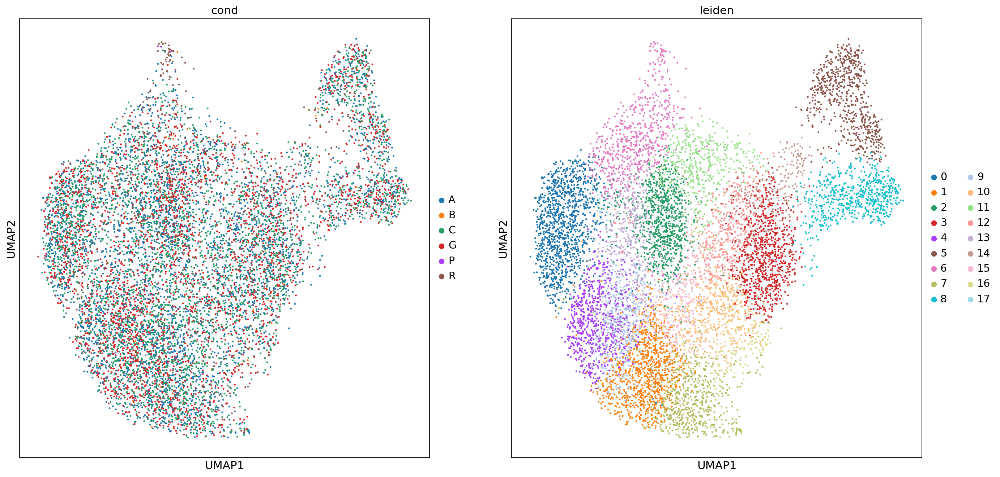

In [58]:
fig, ax = plt.subplots(1, 2, figsize=(20,10))
for color, ax, palette in zip(['cond', 'leiden'], ax, [None, sc.pl.palettes.default_20]):
    sc.pl.umap(acg_t,color=color, ax=ax, show=False, return_fig=False, size=20, palette=palette)

In [59]:
acg_t = acg_t[~(acg_t.obs['leiden'].isin(['8','18']))].copy()

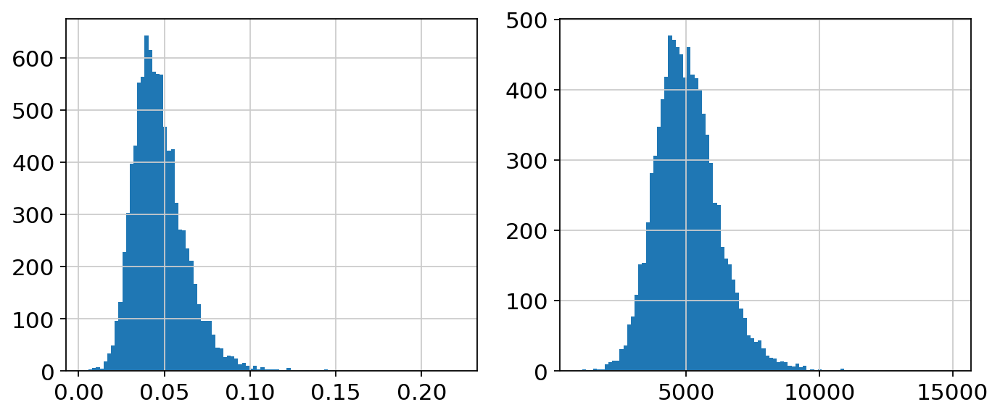

In [60]:
fig, ax = plt.subplots(1,2,figsize=(10,4))
for vals, ax in zip(['percent_mito','n_counts'], np.ravel(ax)):
    ax.hist(acg_t.obs[vals].values,bins=100)

In [61]:
acg_t = acg_t[acg_t.obs['n_counts'] < 10000].copy()
acg_t = acg_t[acg_t.obs['percent_mito'] < 0.125].copy()

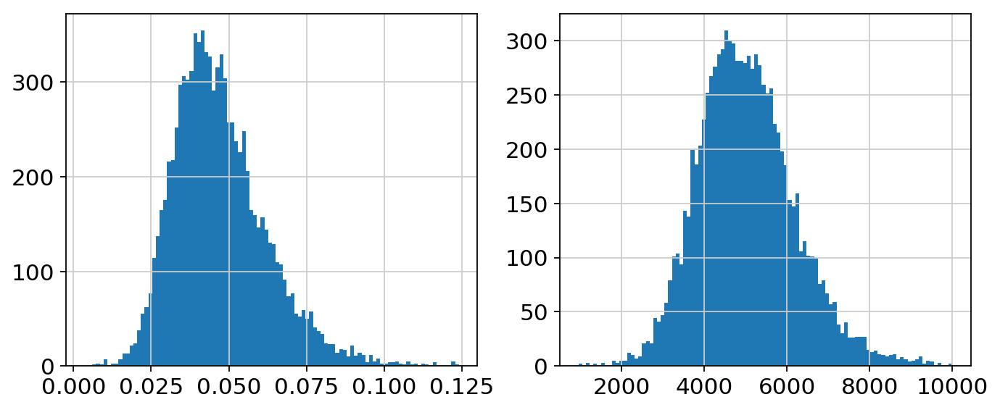

In [62]:
fig, ax = plt.subplots(1,2,figsize=(10,4))
for vals, ax in zip(['percent_mito','n_counts'], np.ravel(ax)):
    ax.hist(acg_t.obs[vals].values,bins=100)

In [63]:
acg_t = wells[0]['adata'].concatenate(*[wells[i]['adata'] for  i in range(1, 12)])[acg_t.obs_names].copy()

In [64]:
acg_t.var['n_counts'] = acg_t.X.toarray().sum(axis=0)

In [65]:
# remove any genes that are now empty
sc.pp.filter_genes(acg_t, min_counts=100, inplace=True)
sc.pp.normalize_per_cell(acg_t, counts_per_cell_after=1e6)
sc.pp.log1p(acg_t)

filtered out 9344 genes that are detected in less than 100 counts
normalizing by total count per cell
    finished (0:00:00): normalized adata.X and added    'n_counts', counts per cell before normalization (adata.obs)


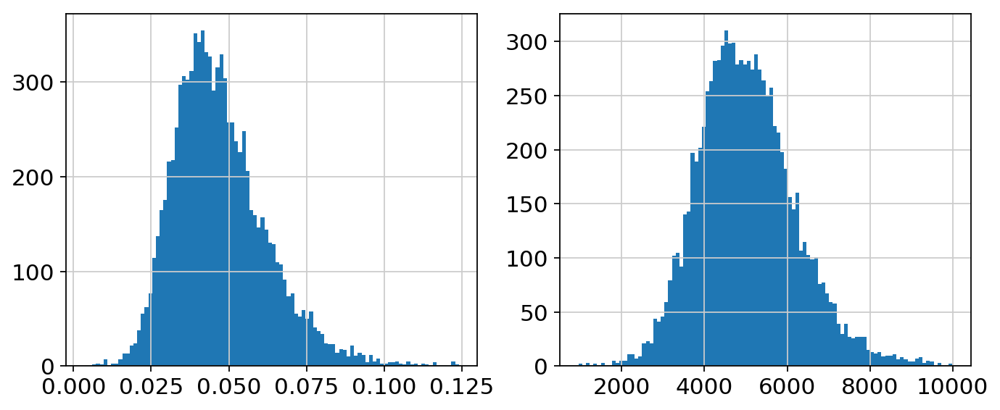

In [66]:
fig, ax = plt.subplots(1,2,figsize=(10,4))
for vals, ax in zip(['percent_mito','n_counts'], np.ravel(ax)):
    ax.hist(acg_t.obs[vals].values,bins=100)

In [67]:
# sc.pp.scale(acg_t)
# sc.pp.regress_out(acg_t, ['percent_mito', 'n_counts'])
sc.pp.scale(acg_t)
sc.pp.combat(acg_t, key='batch',covariates=['cond','free_id'])
sc.pp.scale(acg_t)
sc.pp.pca(acg_t, n_comps=100)

    ... scale_data: as `zero_center=True`, sparse input is densified and may lead to large memory consumption.


... storing 'DROPLET.TYPE' as categorical
... storing 'cond' as categorical
... storing 'exp_id' as categorical
... storing 'free_id' as categorical
... storing 'pool_code' as categorical
... storing 'feature_types' as categorical
... storing 'genome' as categorical


Standardizing Data across genes.

Found 12 batches

Found 2 categorical variables:
	cond, free_id

Found 0 numerical variables:
	

Fitting L/S model and finding priors

Finding parametric adjustments

Adjusting data

computing PCA with n_comps = 100
    finished (0:00:55)
    and added
    'X_pca', the PCA coordinates (adata.obs)
    'PC1', 'PC2', ..., the loadings (adata.var)
    'pca_variance', the variance / eigenvalues (adata.uns)
    'pca_variance_ratio', the variance ratio (adata.uns)


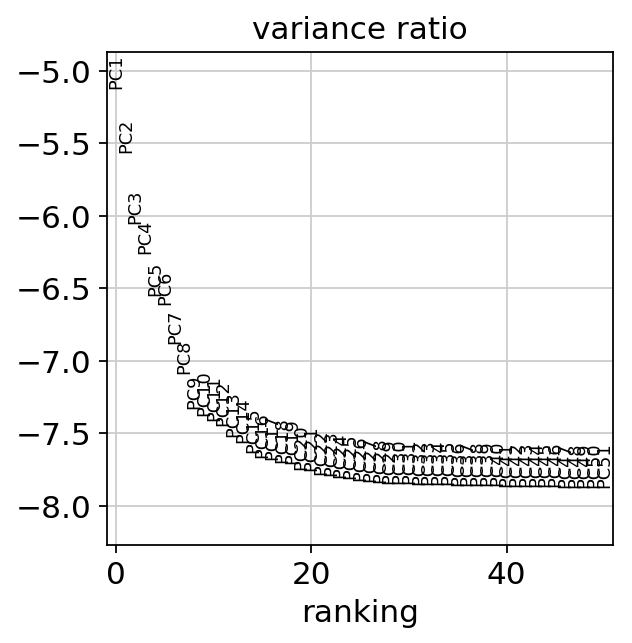

In [68]:
sc.pl.pca_variance_ratio(acg_t,log=True, n_pcs=50)

In [69]:
warnings.filterwarnings('ignore')
sc.pp.neighbors(acg_t,n_neighbors=15,n_pcs=30)
warnings.filterwarnings('default')

computing neighbors
    computing neighbors
    using 'X_pca' with n_pcs = 30
    computed neighbors (0:00:03)
    computed connectivities (0:00:00)
    finished: added to `.uns['neighbors']`
    'distances', distances for each pair of neighbors
    'connectivities', weighted adjacency matrix (0:00:03)


In [70]:
sc.tl.umap(acg_t)

computing UMAP
	completed  0  /  500 epochs
	completed  50  /  500 epochs
	completed  100  /  500 epochs
	completed  150  /  500 epochs
	completed  200  /  500 epochs
	completed  250  /  500 epochs
	completed  300  /  500 epochs
	completed  350  /  500 epochs
	completed  400  /  500 epochs
	completed  450  /  500 epochs
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:24)


In [71]:
sc.tl.leiden(acg_t, resolution=1)

running Leiden clustering
    finished: found 11 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:04)


# Visualization

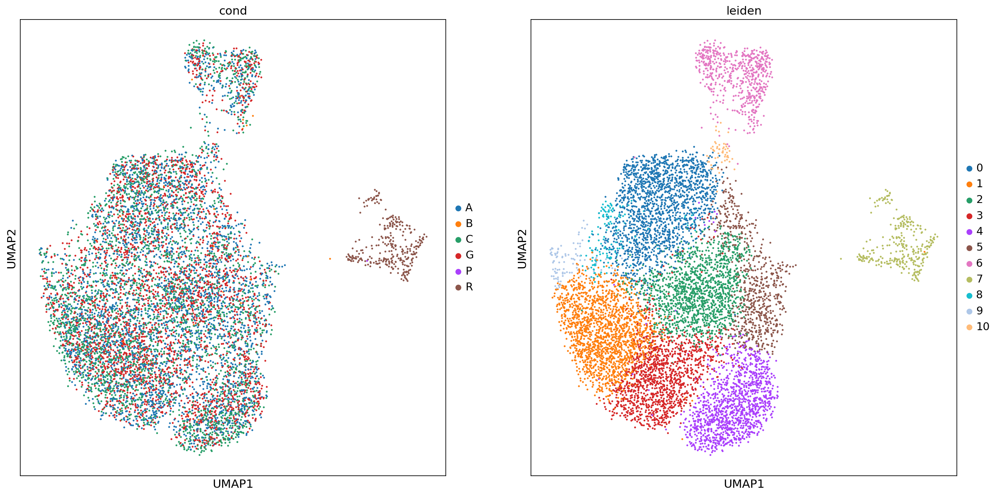

In [72]:
fig, ax = plt.subplots(1, 2, figsize=(20,10))
for color, ax, palette in zip(['cond', 'leiden'], ax, [None, sc.pl.palettes.default_20]):
    sc.pl.umap(acg_t,color=color, ax=ax, show=False, return_fig=False, size=20, palette=palette)

In [73]:
def add_raw(adata, transformed=True):
    path = prefix + 'pkls/aggr/wells.sng.w_covars.pkl'
    
    with open(path,'rb') as file:
        wells = pkl.load(file)
    
    for well in wells:
        wells[well]['adata'].obs_names = [i[:16] + '-%s' % well for i in wells[well]['adata'].obs_names]
    
    raw = wells[0]['adata'].concatenate(*[wells[i]['adata'] for  i in range(1, 12)])[adata.obs_names,:]
    
    if transformed == True:
        sc.pp.normalize_per_cell(raw,counts_per_cell_after=1e6)
        sc.pp.log1p(raw)
    
    adata.raw = raw
    return

In [74]:
add_raw(acg_t)

normalizing by total count per cell


Trying to set attribute `.obs` of view, copying.


    finished (0:00:00): normalized adata.X and added    'n_counts', counts per cell before normalization (adata.obs)


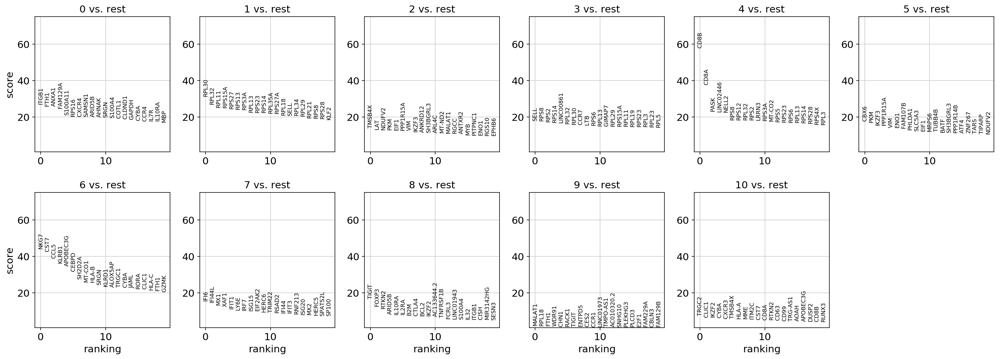

In [75]:
sc.settings.verbosity = 0
warnings.filterwarnings('ignore')
sc.tl.rank_genes_groups(acg_t, groupby='leiden', n_genes=100, use_raw=True)
warnings.filterwarnings('default')
sc.pl.rank_genes_groups(acg_t, ncols=6, n_genes=20)
sc.settings.verbosity = 4

In [76]:
acg_t = acg_t[~(acg_t.obs['leiden'].isin(['9','7']))].copy()

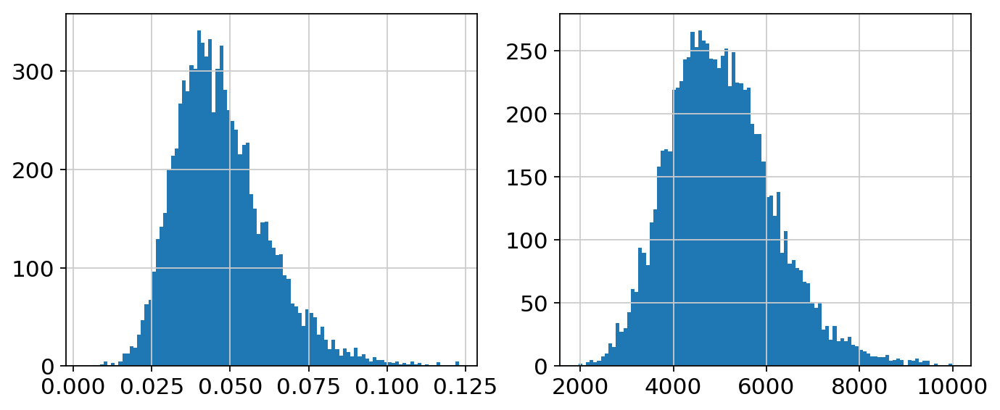

In [77]:
fig, ax = plt.subplots(1,2,figsize=(10,4))
for vals, ax in zip(['percent_mito','n_counts'], np.ravel(ax)):
    ax.hist(acg_t.obs[vals].values,bins=100)

In [78]:
acg_t = wells[0]['adata'].concatenate(*[wells[i]['adata'] for  i in range(1, 12)])[acg_t.obs_names].copy()

In [79]:
acg_t.var['n_counts'] = acg_t.X.toarray().sum(axis=0)

In [80]:
# remove any genes that are now empty
sc.pp.filter_genes(acg_t, min_counts=100, inplace=True)
sc.pp.normalize_per_cell(acg_t, counts_per_cell_after=1e6)
sc.pp.log1p(acg_t)

filtered out 9405 genes that are detected in less than 100 counts
normalizing by total count per cell
    finished (0:00:00): normalized adata.X and added    'n_counts', counts per cell before normalization (adata.obs)


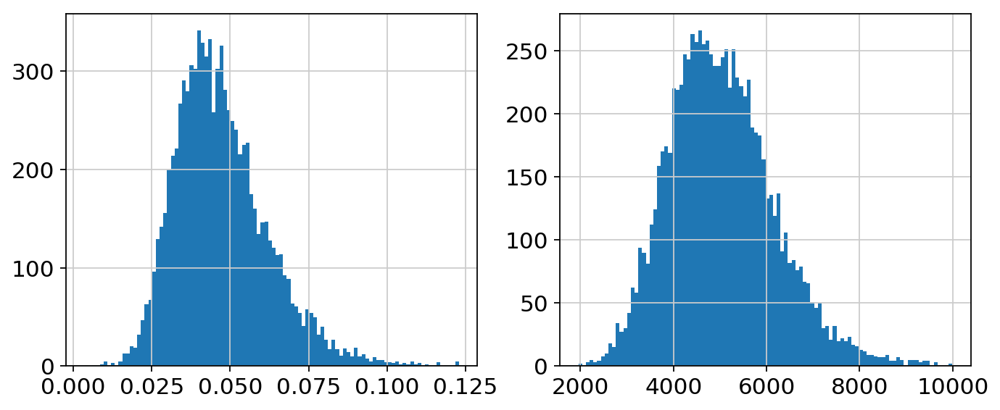

In [81]:
fig, ax = plt.subplots(1,2,figsize=(10,4))
for vals, ax in zip(['percent_mito','n_counts'], np.ravel(ax)):
    ax.hist(acg_t.obs[vals].values,bins=100)

In [82]:
# sc.pp.scale(acg_t)
# sc.pp.regress_out(acg_t, ['percent_mito', 'n_counts'])
sc.pp.scale(acg_t)
sc.pp.combat(acg_t, key='batch',covariates=['cond','free_id'])
sc.pp.scale(acg_t)
sc.pp.pca(acg_t, n_comps=100)

    ... scale_data: as `zero_center=True`, sparse input is densified and may lead to large memory consumption.


... storing 'DROPLET.TYPE' as categorical
... storing 'cond' as categorical
... storing 'exp_id' as categorical
... storing 'free_id' as categorical
... storing 'pool_code' as categorical
... storing 'feature_types' as categorical
... storing 'genome' as categorical


Standardizing Data across genes.

Found 12 batches

Found 2 categorical variables:
	cond, free_id

Found 0 numerical variables:
	

Fitting L/S model and finding priors

Finding parametric adjustments

Adjusting data

computing PCA with n_comps = 100
    finished (0:00:50)
    and added
    'X_pca', the PCA coordinates (adata.obs)
    'PC1', 'PC2', ..., the loadings (adata.var)
    'pca_variance', the variance / eigenvalues (adata.uns)
    'pca_variance_ratio', the variance ratio (adata.uns)


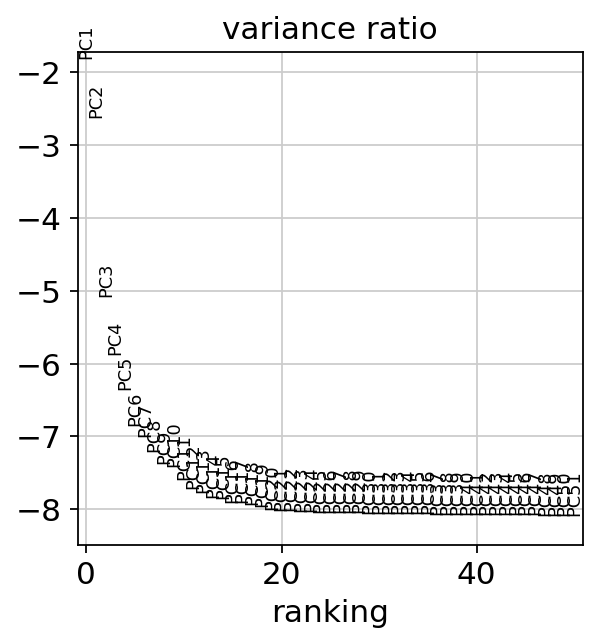

In [83]:
sc.pl.pca_variance_ratio(acg_t,log=True, n_pcs=50)

In [84]:
warnings.filterwarnings('ignore')
sc.pp.neighbors(acg_t,n_neighbors=15,n_pcs=20)
warnings.filterwarnings('default')

computing neighbors
    computing neighbors
    using 'X_pca' with n_pcs = 20
    computed neighbors (0:00:02)
    computed connectivities (0:00:00)
    finished: added to `.uns['neighbors']`
    'distances', distances for each pair of neighbors
    'connectivities', weighted adjacency matrix (0:00:02)


In [85]:
sc.tl.umap(acg_t)

computing UMAP


/home/ssm-user/anaconda3/envs/codec/lib/python3.6/site-packages/umap/spectral.py:229: UserWarning: Embedding a total of 4 separate connected components using meta-embedding (experimental)
  n_components


	completed  0  /  500 epochs
	completed  50  /  500 epochs
	completed  100  /  500 epochs
	completed  150  /  500 epochs
	completed  200  /  500 epochs
	completed  250  /  500 epochs
	completed  300  /  500 epochs
	completed  350  /  500 epochs
	completed  400  /  500 epochs
	completed  450  /  500 epochs
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:21)


In [86]:
sc.tl.leiden(acg_t, resolution=1)

running Leiden clustering
    finished: found 18 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:01)


# Visualization

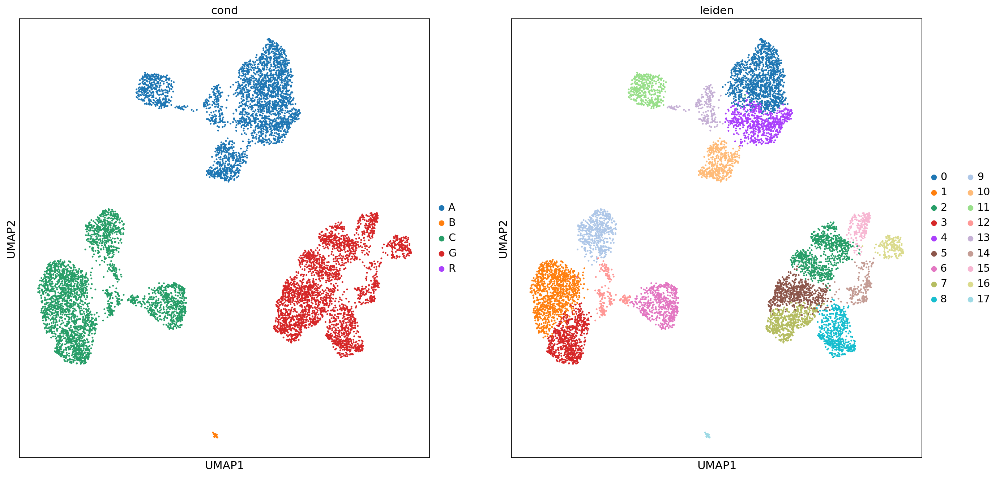

In [87]:
fig, ax = plt.subplots(1, 2, figsize=(20,10))
for color, ax, palette in zip(['cond', 'leiden'], ax, [None, sc.pl.palettes.default_20]):
    sc.pl.umap(acg_t,color=color, ax=ax, show=False, return_fig=False, size=20, palette=palette)

# RUN 7

In [8]:
# acg_t_cells_subset = np.random.choice(acg_t_cells, size=10000, replace=False)

In [31]:
for well in wells:
    wells[well]['adata'].obs_names = [i[:16] + '-%s' % well for i in wells[well]['adata'].obs_names]

In [32]:
# acg_t = wells[0]['adata'].concatenate(*[wells[i]['adata'] for  i in range(1, 12)])[acg_t_cells_subset].copy()
acg_t = wells[0]['adata'].concatenate(*[wells[i]['adata'] for  i in range(1, 12)])[acg_t_cells].copy()

In [33]:
c = acg_t[acg_t.obs['cond'] == 'C'].copy()

In [34]:
c.var['n_counts'] = c.X.toarray().sum(axis=0)

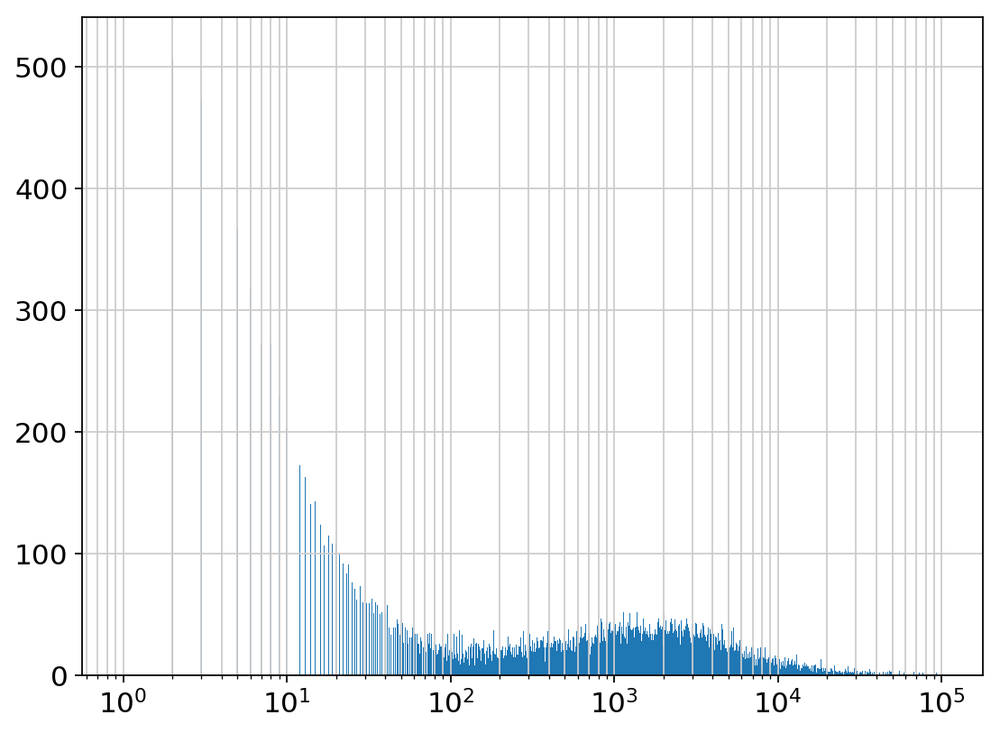

In [35]:
plt.figure(figsize=(8,6))
plt.hist(c.var['n_counts'].values, bins=np.logspace(np.log10(1),np.log10(1e5), 1000))
plt.grid(False)
plt.grid(True, 'both', 'both')
plt.xscale('log')
# plt.yscale('log')

In [36]:
# remove any genes that are now empty
sc.pp.filter_genes(c, min_counts=100, inplace=True)
sc.pp.normalize_per_cell(c, counts_per_cell_after=1e6)
sc.pp.log1p(c)

filtered out 8456 genes that are detected in less than 100 counts
normalizing by total count per cell
    finished (0:00:00): normalized adata.X and added    'n_counts', counts per cell before normalization (adata.obs)


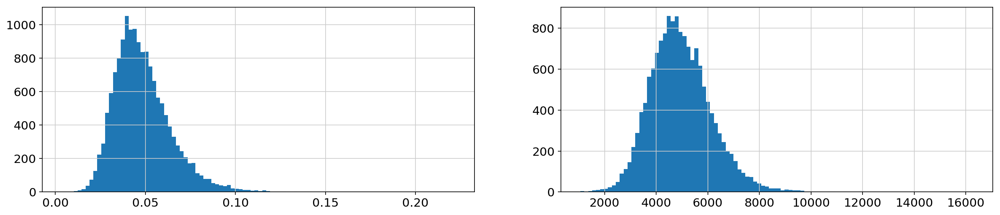

In [38]:
fig, ax = plt.subplots(1,2,figsize=(20,4))
for vals, ax in zip(['percent_mito','n_counts'], np.ravel(ax)):
    ax.hist(c.obs[vals].values,bins=100)

In [39]:
c = c[c.obs['n_counts'] > 1500].copy()
c = c[c.obs['n_counts'] < 10000].copy()
c = c[c.obs['percent_mito'] < 0.125].copy()

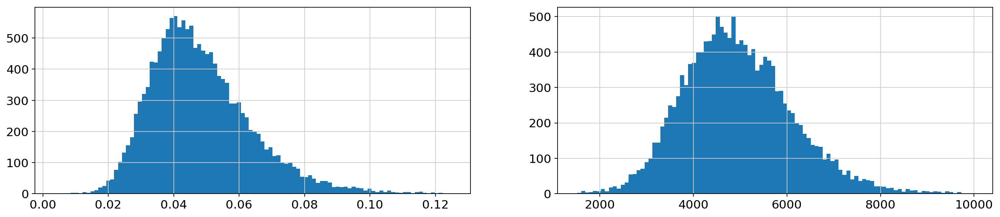

In [46]:
fig, ax = plt.subplots(1,2,figsize=(20,4))
for vals, ax in zip(['percent_mito','n_counts'], np.ravel(ax)):
    ax.hist(c.obs[vals].values,bins=100)

In [40]:
sc.pp.scale(c)
sc.pp.combat(c, key='batch')
sc.pp.scale(c)
sc.pp.pca(c, n_comps=60)

    ... scale_data: as `zero_center=True`, sparse input is densified and may lead to large memory consumption.


... storing 'DROPLET.TYPE' as categorical
... storing 'cond' as categorical
... storing 'exp_id' as categorical
... storing 'free_id' as categorical
... storing 'pool_code' as categorical
... storing 'feature_types' as categorical
... storing 'genome' as categorical


Standardizing Data across genes.

Found 12 batches

Found 0 numerical variables:
	

Fitting L/S model and finding priors

Finding parametric adjustments



/home/ssm-user/anaconda3/envs/codec/lib/python3.6/site-packages/scanpy/preprocessing/_combat.py:338: RuntimeWarning: divide by zero encountered in true_divide
  change = max((abs(g_new - g_old) / g_old).max(), (abs(d_new - d_old) / d_old).max())


Adjusting data

computing PCA with n_comps = 60
    finished (0:01:09)
    and added
    'X_pca', the PCA coordinates (adata.obs)
    'PC1', 'PC2', ..., the loadings (adata.var)
    'pca_variance', the variance / eigenvalues (adata.uns)
    'pca_variance_ratio', the variance ratio (adata.uns)


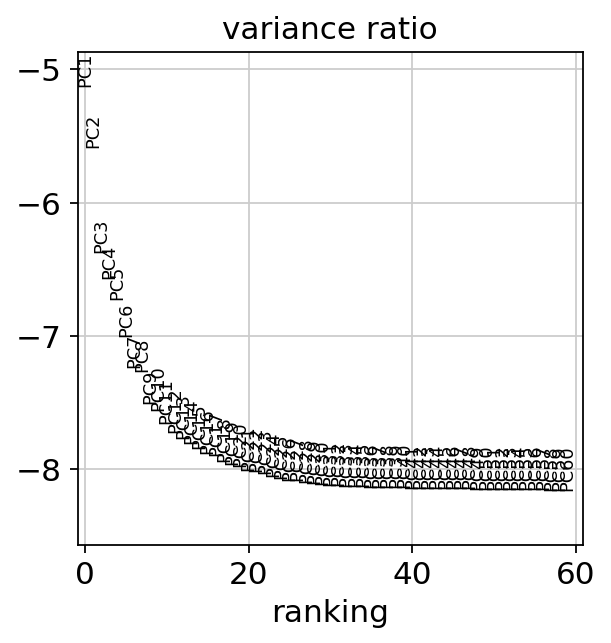

In [41]:
sc.pl.pca_variance_ratio(c,log=True, n_pcs=60)

In [42]:
warnings.filterwarnings('ignore')
sc.pp.neighbors(c,n_neighbors=15,n_pcs=40)
warnings.filterwarnings('default')

computing neighbors
    computing neighbors
    using 'X_pca' with n_pcs = 40
    computed neighbors (0:00:05)
    computed connectivities (0:00:00)
    finished: added to `.uns['neighbors']`
    'distances', distances for each pair of neighbors
    'connectivities', weighted adjacency matrix (0:00:05)


In [43]:
sc.tl.umap(c)

computing UMAP
	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:15)


In [44]:
sc.tl.leiden(c, resolution=1)

running Leiden clustering
    finished: found 10 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:04)


# Visualization

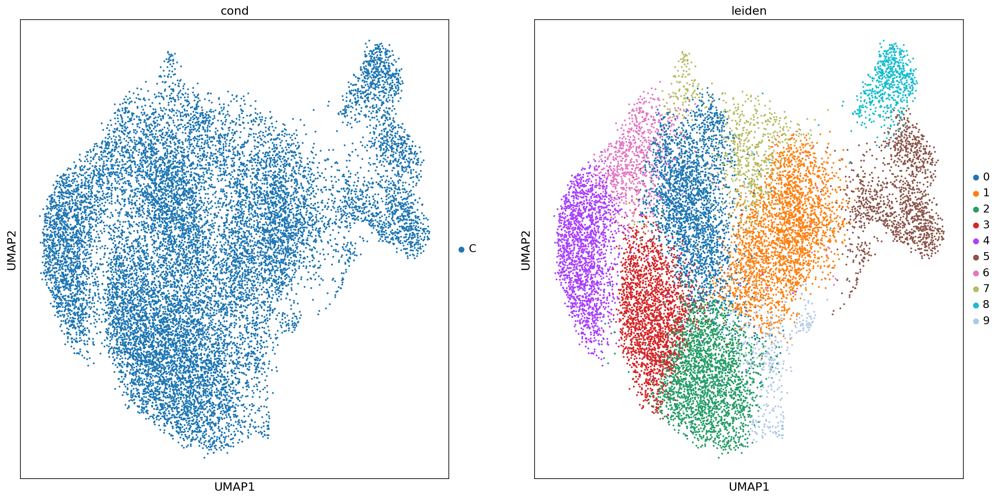

In [45]:
fig, ax = plt.subplots(1, 2, figsize=(20,10))
for color, ax, palette in zip(['cond', 'leiden'], ax, [None, sc.pl.palettes.default_20]):
    sc.pl.umap(c,color=color, ax=ax, show=False, return_fig=False, size=20, palette=palette)

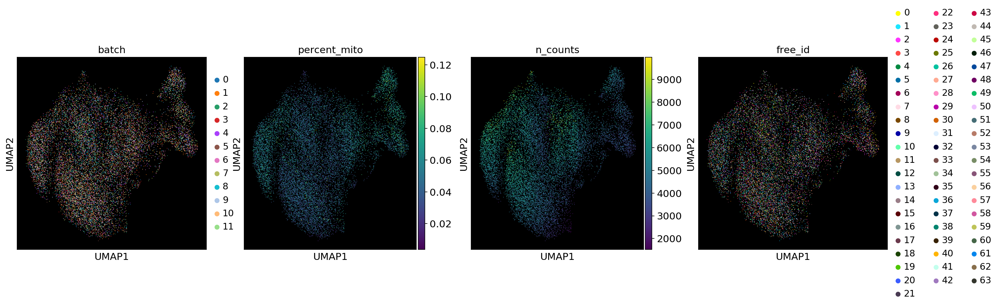

In [47]:
fig, ax = plt.subplots(1,4,figsize=(22,5))
for f, ax in zip(['batch', 'percent_mito', 'n_counts', 'free_id'], np.ravel(ax)):
    ax.set_facecolor('black')
    sc.pl.umap(c, color=f, ax=ax,show=False, return_fig=False, size=3);

In [50]:
def add_raw(adata, transformed=True):
    path = prefix + 'pkls/aggr/wells.sng.w_covars.pkl'
    
    with open(path,'rb') as file:
        wells = pkl.load(file)
    
    for well in wells:
        wells[well]['adata'].obs_names = [i[:16] + '-%s' % well for i in wells[well]['adata'].obs_names]
    
    raw = wells[0]['adata'].concatenate(*[wells[i]['adata'] for  i in range(1, 12)])[adata.obs_names,:]
    
    if transformed == True:
        sc.pp.normalize_per_cell(raw,counts_per_cell_after=1e6)
        sc.pp.log1p(raw)
    
    adata.raw = raw
    return

In [51]:
add_raw(c)

normalizing by total count per cell


Trying to set attribute `.obs` of view, copying.


    finished (0:00:00): normalized adata.X and added    'n_counts', counts per cell before normalization (adata.obs)


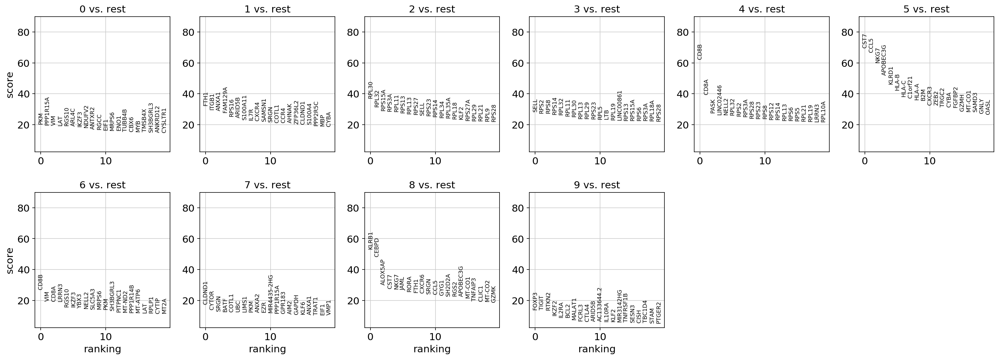

In [52]:
sc.settings.verbosity = 0
warnings.filterwarnings('ignore')
sc.tl.rank_genes_groups(c, groupby='leiden', n_genes=100, use_raw=True)
warnings.filterwarnings('default')
sc.pl.rank_genes_groups(c, ncols=6, n_genes=20)
sc.settings.verbosity = 4

# Single Gene Plotter

In [59]:
f = ['TRDC']

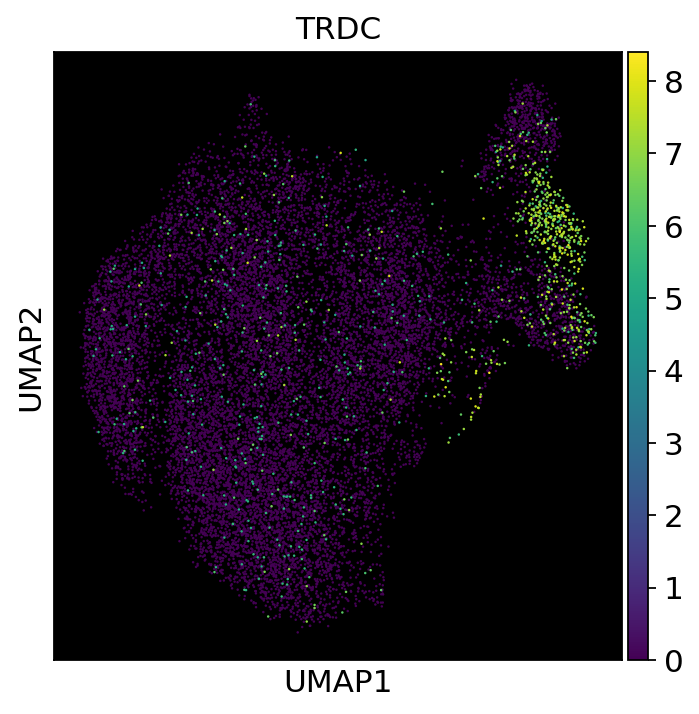

In [60]:
fig, ax = plt.subplots(1,1,figsize=(5,5))
ax.set_facecolor('black')
sc.pl.umap(c, color=f, ax=ax,show=False, return_fig=False, size=5, use_raw=True);